In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px # to plot the time series plot
from sklearn import metrics # for the evaluation
from sklearn.preprocessing import LabelEncoder,MinMaxScaler
import tensorflow as tf


In [ ]:
data = pd.read_csv('/content/drive/MyDrive/2022_04_13 - rainy.csv')#[:-1]
 #data.plot(color='red')

In [ ]:
for i in data.select_dtypes('object').columns:
   le = LabelEncoder().fit(data[i])
   data[i] = le.transform(data[i])
data

,date,time,power,pix,Unnamed: 4
0,0,1081,0.0,0,NaN
1,0,1082,0.0,0,NaN
2,0,1083,0.0,0,NaN
3,0,1084,0.0,0,NaN
4,0,1085,0.0,0,NaN
...,...,...,...,...,...
6235,0,1076,0.0,0,NaN
6236,0,1077,0.0,0,NaN
6237,0,1078,0.0,0,NaN
6238,0,1079,0.0,0,NaN


Index(['date', 'time', 'power', 'pix', 'Unnamed: 4'], dtype='object')
6240


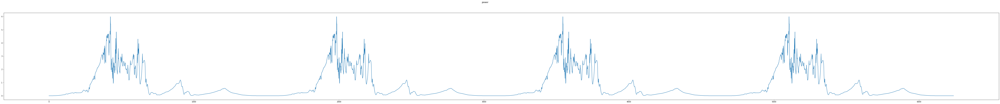

In [ ]:
data.columns
print(data.columns)
all_data = data['power'].values.astype(float)
print(len(all_data))

#training_set = training_set.iloc[:,1:2].values
plt.figure(figsize=(100,9))
plt.plot(all_data)

#plt.plot(power, label = 'AVG power2')
plt.suptitle('power')
plt.show()


Index(['date', 'time', 'power', 'pix', 'Unnamed: 4'], dtype='object')
6240


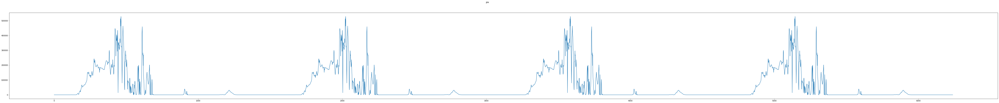

In [ ]:
data.columns
print(data.columns)
pix_data = data['pix'].values.astype(float)

print(len(all_data))
plt.figure(figsize=(100,9))

plt.plot(pix_data)

plt.suptitle('pix')
plt.show()


Index(['date', 'time', 'power', 'pix', 'Unnamed: 4'], dtype='object')
6240


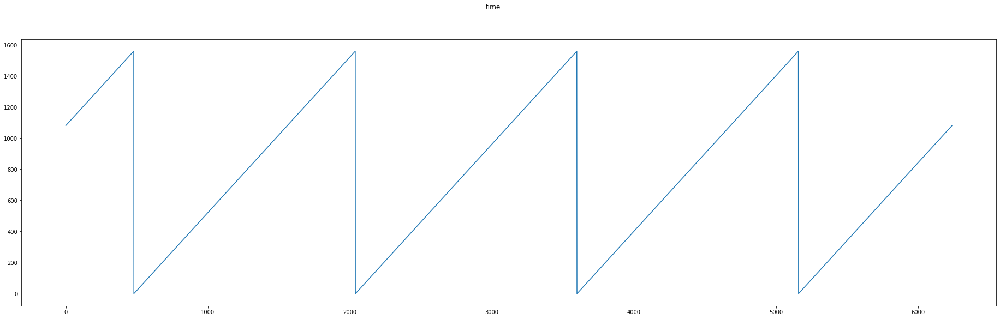

In [ ]:
data.columns
print(data.columns)
pix_data = data['time'].values.astype(float)

print(len(all_data))
plt.figure(figsize=(32,9))



plt.plot(pix_data)

plt.suptitle('time')
plt.show()

In [ ]:
X_scaler = MinMaxScaler()
Y_scaler = MinMaxScaler()
X_data = X_scaler.fit_transform(data[['pix']])
X_data1 = X_scaler.fit_transform(data[['power']])
Y_data = Y_scaler.fit_transform(data[['power']]) #np.array(data[['power']])#
X_data
Y_data

array([[0.],
       [0.],
       [0.],
       ...,
       [0.],
       [0.],
       [0.]])

In [ ]:
def custom_ts_multi_data_prep(dataset, target, start, end, window, horizon):
    X = []
    y = []
    start = start + window
    if end is None:
       end = len(dataset) - horizon
    for i in range(start, end):
       indices = range(i-window, i)
       X.append(dataset[indices])
       #print(X)
       indicey = range(i+1, i+1+horizon)
       y.append(target[indicey][-1])
    return np.array(X), np.array(y)

In [ ]:
hist_window = 80
horizon = 20
TRAIN_SPLIT = int(len(X_data)*0.7)

x_train, y_train = custom_ts_multi_data_prep(X_data, Y_data, 0, TRAIN_SPLIT, hist_window, horizon)
x_vali, y_vali = custom_ts_multi_data_prep(X_data, Y_data, TRAIN_SPLIT, None, hist_window, horizon)

x_train1, y_train1 = custom_ts_multi_data_prep(X_data1, Y_data, 0, TRAIN_SPLIT, hist_window, horizon)
x_vali1, y_vali1 = custom_ts_multi_data_prep(X_data1, Y_data, TRAIN_SPLIT, None, hist_window, horizon)
print(len(x_train),len(x_train1))
#len(Y_data)

4288 4288


In [ ]:
#print ('Multiple window of past history\n')
#print(x_train[0])
#print ('\n Target horizon\n')
#print (y_train[0])

In [ ]:
batch_size = 64
buffer_size = 10
train_data = tf.data.Dataset.from_tensor_slices((x_train, y_train))
train_data = train_data.cache().shuffle(buffer_size).batch(batch_size).repeat()
val_data = tf.data.Dataset.from_tensor_slices((x_vali, y_vali))
val_data = val_data.batch(batch_size).repeat()

train_data1 = tf.data.Dataset.from_tensor_slices((x_train1, y_train1))
train_data1 = train_data1.cache().shuffle(buffer_size).batch(batch_size).repeat()
val_data1 = tf.data.Dataset.from_tensor_slices((x_vali1, y_vali1))
val_data1 = val_data1.batch(batch_size).repeat()
val_data
x_train.shape[-2:]


(80, 1)

In [ ]:
lstm_model = tf.keras.models.Sequential([
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences=True),input_shape=x_train.shape[-2:]),
  #tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences= True)),
  # # #tf.keras.layers.Dropout(0.2),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(8, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(8, return_sequences= True)),
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences= True)),
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences= True)),
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(8, return_sequences= True)),
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(8, return_sequences= False)),
  #tf.keras.layers.Dense(2, activation='tanh'),
  tf.keras.layers.Dense(8, activation='tanh'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(4, activation='tanh'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(4, activation='tanh'),
  tf.keras.layers.Dropout(0.2),
  #tf.keras.layers.Dense(2, activation='tanh'),
  tf.keras.layers.Dense(2, activation='tanh'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(1),
 ])
lstm_model.compile(optimizer='adam', loss='mse')
lstm_model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_27 (Bidirecti  (None, 80, 64)           8704      
 onal)                                                           
                                                                 
 bidirectional_28 (Bidirecti  (None, 80, 64)           24832     
 onal)                                                           
                                                                 
 bidirectional_29 (Bidirecti  (None, 80, 32)           10368     
 onal)                                                           
                                                                 
 bidirectional_30 (Bidirecti  (None, 80, 32)           6272      
 onal)                                                           
                                                                 
 bidirectional_31 (Bidirecti  (None, 80, 16)          

In [ ]:
model_path = '/content/drive/MyDrive/SkyImageModel_13.h5'
early_stopings = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=1, mode='min')
checkpoint =  tf.keras.callbacks.ModelCheckpoint(model_path, monitor='val_loss', save_best_only=True, mode='min', verbose=0)
callbacks=[early_stopings,checkpoint]

In [ ]:
history = lstm_model.fit(train_data,epochs=75,steps_per_epoch=100,validation_data=val_data,validation_steps=50,verbose=1,callbacks=callbacks)

Epoch 1/75
100/100 [==============================] - 27s 112ms/step - loss: 0.0375 - val_loss: 0.0123
Epoch 2/75
100/100 [==============================] - 5s 50ms/step - loss: 0.0216 - val_loss: 0.0135
Epoch 3/75
100/100 [==============================] - 5s 49ms/step - loss: 0.0241 - val_loss: 0.0123
Epoch 4/75
100/100 [==============================] - 5s 49ms/step - loss: 0.0212 - val_loss: 0.0188
Epoch 5/75
100/100 [==============================] - 5s 49ms/step - loss: 0.0225 - val_loss: 0.0124
Epoch 6/75
100/100 [==============================] - 6s 59ms/step - loss: 0.0199 - val_loss: 0.0111
Epoch 7/75
100/100 [==============================] - 5s 51ms/step - loss: 0.0199 - val_loss: 0.0104
Epoch 8/75
100/100 [==============================] - 5s 49ms/step - loss: 0.0212 - val_loss: 0.0114
Epoch 9/75
100/100 [==============================] - 5s 49ms/step - loss: 0.0184 - val_loss: 0.0105
Epoch 10/75
100/100 [==============================] - 6s 58ms/step - loss: 0.0204 - val_

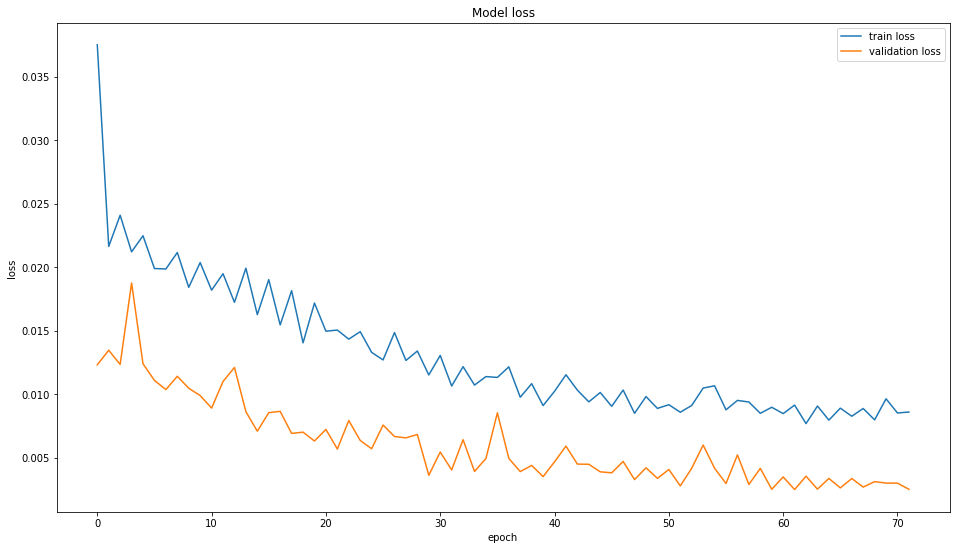

In [ ]:


plt.figure(figsize=(16,9))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train loss', 'validation loss'])
plt.show()

In [ ]:
num = int(len(data[[ 'pix']])/7)

In [ ]:
data_val = X_scaler.fit_transform(data[[ 'pix']])[:num]
Expected = X_scaler.fit_transform(data[['power' ]])[:num]
print(len(Expected))
print(len(data_val))

891
891


In [ ]:
data_for_pred, Expected_val = custom_ts_multi_data_prep(data_val, Expected, 0, None, hist_window, horizon)

In [ ]:
pred = []
print(len(data_for_pred))

for i in data_for_pred:
  #print(len(i))
  #print(i.shpae)
  i = i.reshape(1, i.shape[0], i.shape[1])
  pred.append(lstm_model.predict(i))
  #break
#pred = np.array(pred)
pred[0][0]

791


array([0.02155945], dtype=float32)

In [ ]:
act_pred =[]
for preds in pred:
  #print(preds)

  pred_Inverse = Y_scaler.inverse_transform(preds)
  act_pred.append(pred_Inverse)
len(act_pred)
#act_pred

791

In [ ]:
predn = []
for item in list(act_pred):
  item = float(item[0])
  item = round(item, 2)
  predn.append(item)
  #print(item)
#pred

In [ ]:
Expected = Y_scaler.inverse_transform(Expected)
Expected
Expected_list = []
for item in list(Expected):
  Expected_list.append(float(item[0]))
  #print(item)
len(Expected)

891

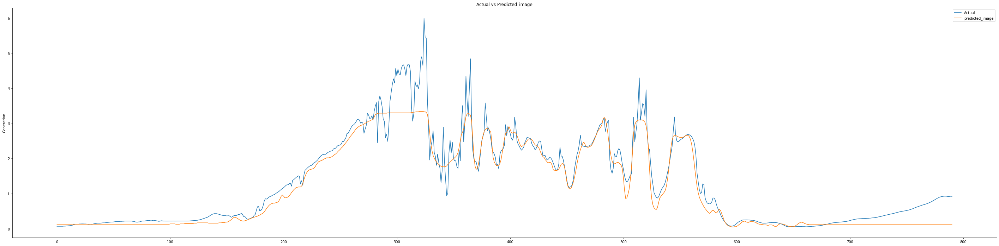

In [ ]:
plt.figure(figsize=(50,12))
#
plt.plot( list(Expected[len(Expected)-len(predn):]))
plt.plot(predn)
# plt.plot(pred1)
plt.title("Actual vs Predicted_image")
plt.ylabel("Generation")
plt.legend(('Actual','predicted_image'))
plt.show()

In [ ]:
lstm_model1 = tf.keras.models.Sequential([
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences=True),input_shape=x_train.shape[-2:]),
  #tf.keras.layers.Dropout(0.2),
  #  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, return_sequences= True)),
  # #tf.keras.layers.Dropout(0.2),
  # # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, return_sequences= True)),
  # # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences= True)),
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(8, return_sequences= True)),
  # tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(8, return_sequences= True)),
  tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(8, return_sequences= False)),
  #tf.keras.layers.Dense(2, activation='tanh'),
  tf.keras.layers.Dense(8, activation='tanh'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(4, activation='tanh'),
  tf.keras.layers.Dropout(0.2),
  #tf.keras.layers.Dense(2, activation='tanh'),
  tf.keras.layers.Dense(2, activation='tanh'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(1),
 ])
lstm_model1.compile(optimizer='adam', loss='mse')
lstm_model1.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_33 (Bidirecti  (None, 80, 64)           8704      
 onal)                                                           
                                                                 
 bidirectional_34 (Bidirecti  (None, 80, 32)           10368     
 onal)                                                           
                                                                 
 bidirectional_35 (Bidirecti  (None, 16)               2624      
 onal)                                                           
                                                                 
 dense_29 (Dense)            (None, 8)                 136       
                                                                 
 dropout_23 (Dropout)        (None, 8)                 0         
                                                      

In [ ]:
model_path = '/content/drive/MyDrive/StatisticsModel_13.h5'
early_stopings = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=1, mode='min')
checkpoint =  tf.keras.callbacks.ModelCheckpoint(model_path, monitor='val_loss', save_best_only=True, mode='min', verbose=0)
callbacks=[early_stopings,checkpoint]

In [ ]:
history = lstm_model1.fit(train_data1,epochs=50,steps_per_epoch=100,validation_data=val_data1,validation_steps=50,verbose=1,callbacks=callbacks)

Epoch 1/50
100/100 [==============================] - 53s 531ms/step - loss: 0.0145 - val_loss: 0.0074
Epoch 2/50
100/100 [==============================] - 3s 26ms/step - loss: 0.0126 - val_loss: 0.0074
Epoch 3/50
100/100 [==============================] - 3s 33ms/step - loss: 0.0139 - val_loss: 0.0064
Epoch 4/50
100/100 [==============================] - 3s 26ms/step - loss: 0.0125 - val_loss: 0.0072
Epoch 5/50
100/100 [==============================] - 3s 26ms/step - loss: 0.0130 - val_loss: 0.0065
Epoch 6/50
100/100 [==============================] - 3s 26ms/step - loss: 0.0122 - val_loss: 0.0092
Epoch 7/50
100/100 [==============================] - 3s 26ms/step - loss: 0.0134 - val_loss: 0.0067
Epoch 8/50
100/100 [==============================] - 3s 26ms/step - loss: 0.0128 - val_loss: 0.0073
Epoch 9/50
100/100 [==============================] - 3s 35ms/step - loss: 0.0120 - val_loss: 0.0061
Epoch 10/50
100/100 [==============================] - 3s 26ms/step - loss: 0.0126 - val_

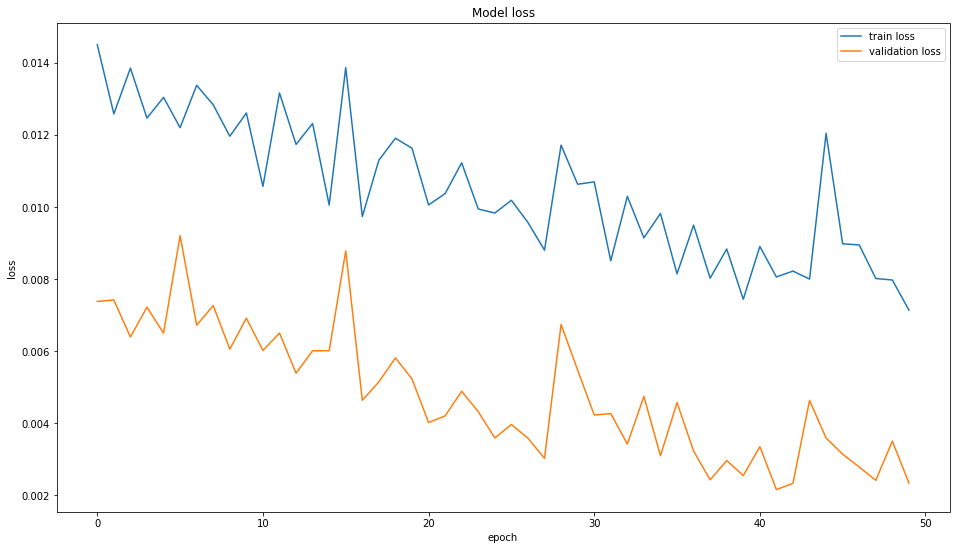

In [ ]:
plt.figure(figsize=(16,9))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train loss', 'validation loss'])
plt.show()

In [ ]:
#num = int(len(data[[ 'pix']])*0.1)

In [ ]:
data_val = X_scaler.fit_transform(data[[ 'pix']])[:num]
Expected = X_scaler.fit_transform(data[['power' ]])[:num]
print(len(Expected))
print(len(data_val))

891
891


In [ ]:
data_val1 = X_scaler.fit_transform(data[[ 'power']])[:num]
Expected1 = X_scaler.fit_transform(data[['power' ]])[:num]
print(len(Expected1))
print(len(data_val1))

891
891


In [ ]:
data_for_pred, Expected_val = custom_ts_multi_data_prep(data_val, Expected, 0, None, hist_window, horizon)
data_for_pred1, Expected_val1 = custom_ts_multi_data_prep(data_val1, Expected1, 0, None, hist_window, horizon)
#data_for_pred[0], Expected_val[0]

In [ ]:
# len(data_for_pred)

In [ ]:
pred = []
print(len(data_for_pred))

for i in data_for_pred:
  #print(len(i))
  #print(i.shpae)
  i = i.reshape(1, i.shape[0], i.shape[1])
  pred.append(lstm_model.predict(i))
  #break
#pred = np.array(pred)
pred[0][0]

791


array([0.02155945], dtype=float32)

In [ ]:
pred1 = []
print(len(data_for_pred1))

for i in data_for_pred1:
  #print(len(i))
  #print(i.shpae)
  i = i.reshape(1, i.shape[0], i.shape[1])
  pred1.append(lstm_model1.predict(i))
  #break
#pred = np.array(pred)
pred1[0][0]

791


array([0.05166705], dtype=float32)

In [ ]:
#pred

In [ ]:
act_pred =[]
for preds in pred:
  #print(preds)

  pred_Inverse = Y_scaler.inverse_transform(preds)
  act_pred.append(pred_Inverse)
len(act_pred)
#act_pred

791

In [ ]:
act_pred1 =[]
for preds in pred1:
  #print(preds)

  pred_Inverse = Y_scaler.inverse_transform(preds)
  act_pred1.append(pred_Inverse)
len(act_pred1)

791

In [ ]:
predn = []
for item in list(act_pred):
  item = float(item[0])
  item = round(item, 2)
  predn.append(item)
  #print(item)
#pred

In [ ]:
predn1 = []
for item in list(act_pred1):
  item = float(item[0])
  item = round(item, 2)
  predn1.append(item)
  #print(item)
#pred

In [ ]:
len(Expected), len(pred)

(891, 791)

In [ ]:
Expected = Y_scaler.inverse_transform(Expected)
Expected
Expected_list = []
for item in list(Expected):
  Expected_list.append(float(item[0]))
  #print(item)
len(Expected)

891

In [ ]:
Expected1 = Expected[len(Expected)-len(predn):]

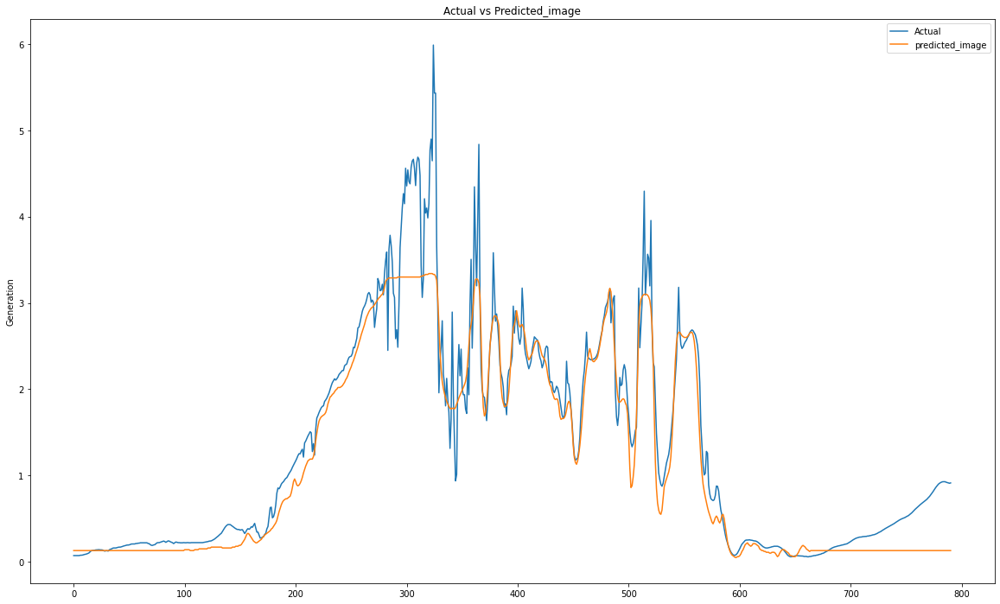

In [ ]:
plt.figure(figsize=(20,12))
#
plt.plot( list(Expected1))
plt.plot(predn)
# plt.plot(pred1)
plt.title("Actual vs Predicted_image")
plt.ylabel("Generation")
plt.legend(('Actual','predicted_image'))
plt.show()

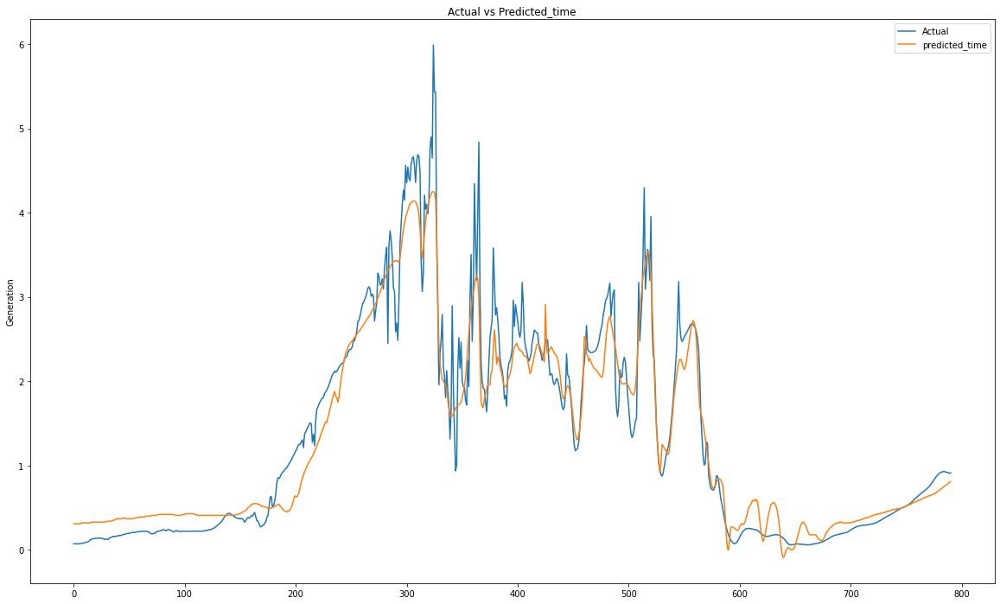

In [ ]:
plt.figure(figsize=(20,12))
#
plt.plot( list(Expected1))
plt.plot(predn1)
#plt.plot(pred1)
plt.title("Actual vs Predicted_time")
plt.ylabel("Generation")
plt.legend(('Actual','predicted_time'))
plt.show()

In [ ]:
rmse = []
for i in range(len(Expected1)):
  per_err = (Expected1[i][0] - predn[i])**2
  # print(per_err)
  rmse.append(per_err)
rmse = list(rmse)
rmse = (sum(rmse)/len(rmse))**0.5
print('rmse value sky imagery model',rmse)

rmse value sky imagery model 0.3657704873357274


In [ ]:
rmse = []
for i in range(len(predn1)):
  per_err = (Expected1[i][0] - predn1[i])**2
  rmse.append(per_err)
rmse = list(rmse)
rmse = (sum(rmse)/len(rmse))**0.5
print('rmse value statistical model',rmse)

rmse value statistical model 0.302372320705282


In [ ]:
mape = []
count = 0
for i in range(len(pred1)):
  if (Expected[i][0] > pred1[i]):
    count+=1
  per_err = (Expected[i][0] - pred1[i]) / pred1[i]
  per_err = abs(per_err)
  #print(Expected[i][0],pred[i],Expected[i][0]-pred[i], per_err)
  mape.append(per_err)
mape = list(mape)
mape = sum(mape)/len(mape)
mape

array([[10861.614]], dtype=float32)

In [ ]:
def rmse1(pred, expected):
  rmse = []

  for i in range(len(pred)):
    per_err = (Expected1[i][0] - pred[i])**2
    rmse.append(per_err)
  rmse = list(rmse)
  rmse = (sum(rmse)/len(rmse))**0.5
  return rmse

In [ ]:
predn1[0]*0.9

0.279

In [ ]:
ensemble = []
for i in range(len(pred)):
  ensemble.append((predn[i]*0.9+predn1[i]*0.1))
print(ensemble)
rmse1(ensemble,Expected1)


[0.14800000000000002, 0.14800000000000002, 0.14800000000000002, 0.14800000000000002, 0.14800000000000002, 0.14800000000000002, 0.14800000000000002, 0.14900000000000002, 0.14900000000000002, 0.14900000000000002, 0.14900000000000002, 0.14900000000000002, 0.14900000000000002, 0.14900000000000002, 0.14900000000000002, 0.14900000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15000000000000002, 0.15100000000000002, 0.15100000000000002, 0.15100000000000002, 0.15100000000000002, 0.15100000000000002, 0.152, 0.152, 0.153, 0.153, 0.154, 0.154, 0.154, 0.154, 0.154, 0.154, 0.15500000000000003, 0.15500000000000003, 0.154, 0.154, 0.154, 0.154, 0.154, 0.154, 0.154, 0.154, 0.15500000000000003, 0.15500000000000003, 0.15500000000000003, 0.15500000000000003, 0.1560000000

0.34723208915953996

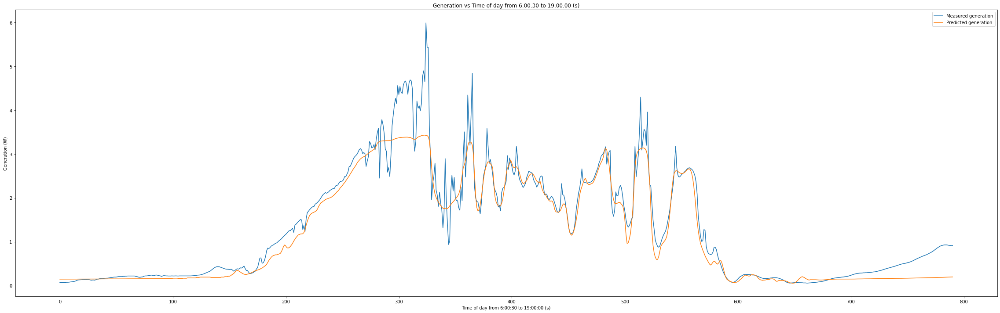

In [ ]:
plt.figure(figsize=(40,12))
#
plt.plot( list(Expected1))
plt.plot(ensemble)
#plt.plot(pred1)
plt.title("Generation vs Time of day from 6:00:30 to 19:00:00 (s)")
plt.ylabel("Generation (W)")
plt.xlabel("Time of day from 6:00:30 to 19:00:00 (s)")
plt.legend(('Measured generation','Predicted generation'))
plt.show()

In [ ]:
weights_list = list(range(0,100,1))
print(weights_list)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]


In [ ]:

ensemble = []
RMSE = []
for weight in weights_list:
  weight = weight/100
  ensemble_new=[]
  for i in range(len(pred)):
    ensemble_new.append((predn[i]*(1-weight)+predn1[i]*weight))


  RMSE.append(rmse1(ensemble_new,Expected1))
  ensemble.append(ensemble_new)

In [ ]:
ensemble[0]


[0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.13,
 0.14,
 0.14,
 0.14,
 0.14,
 0.14,
 0.13,
 0.13,
 0.13,
 0.13,
 0.14,
 0.14,
 0.14,
 0.14,
 0.15,
 0.15,
 0.15,
 0.15,
 0.15,
 0.15,
 0.15,
 0.15,
 0.16,
 0.16,
 0.16,
 0.17,
 0.17,
 0.17,
 0.17,
 0.17,
 0.17,
 0.17,
 0.17,
 0.17,
 0.17,
 0.16,
 0.16,
 0.16,
 0.16,
 0.16,
 0.16,
 0.16,
 0.16,
 0.16,

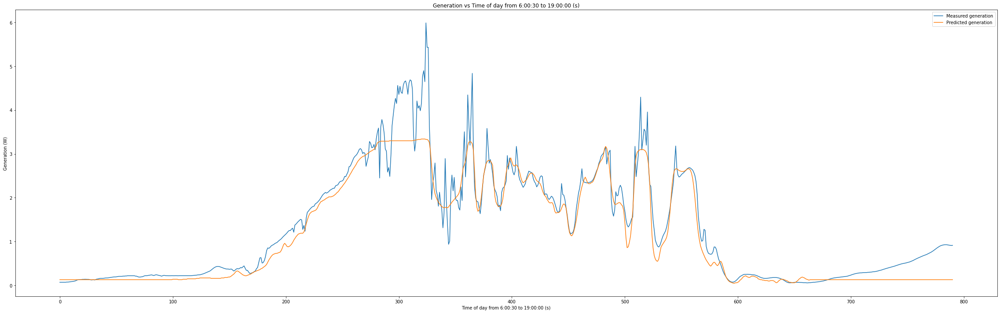

0.3657704873357274 0.0


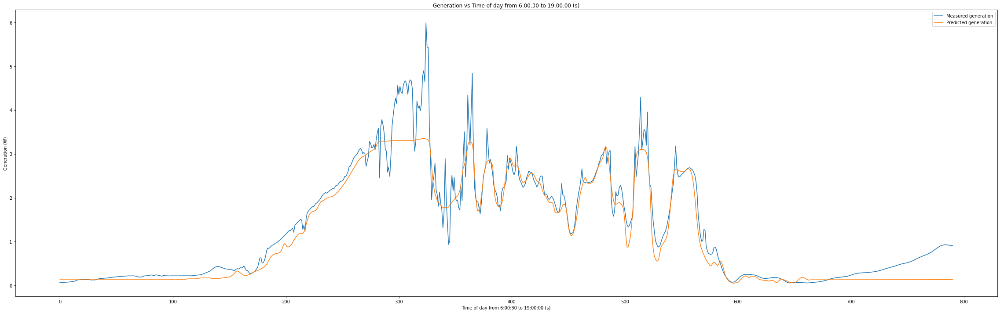

0.3638357275088358 0.01


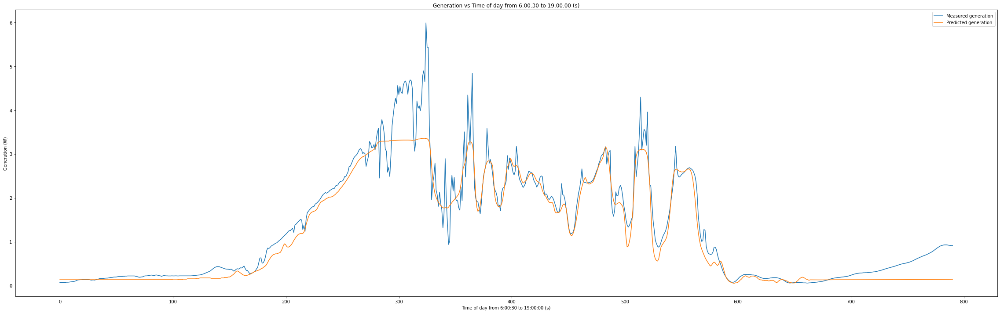

0.36191820052122414 0.02


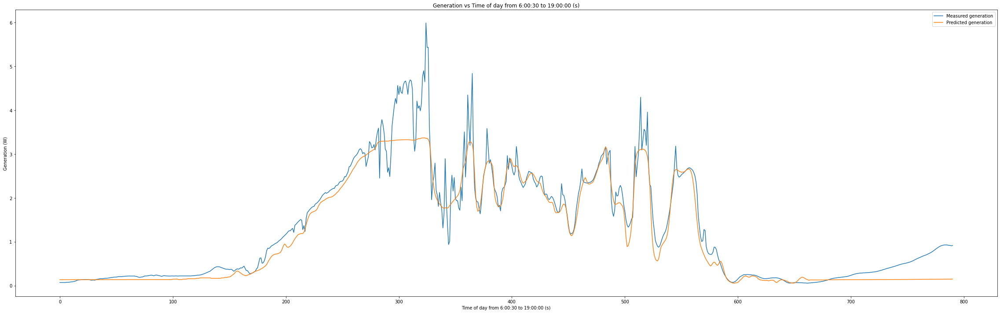

0.36001818172937733 0.03


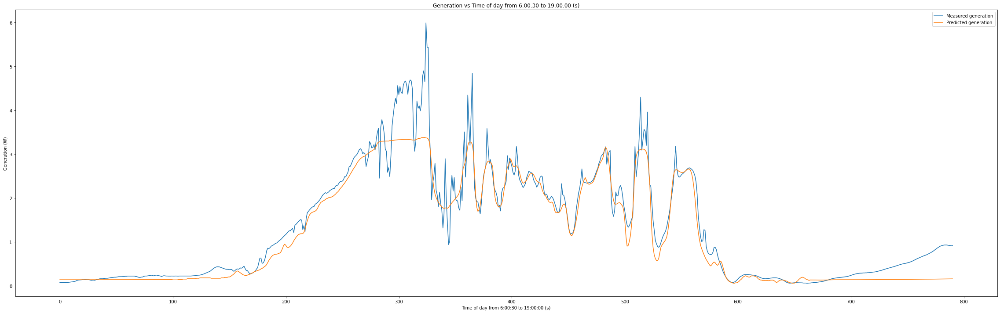

0.3581359497921174 0.04


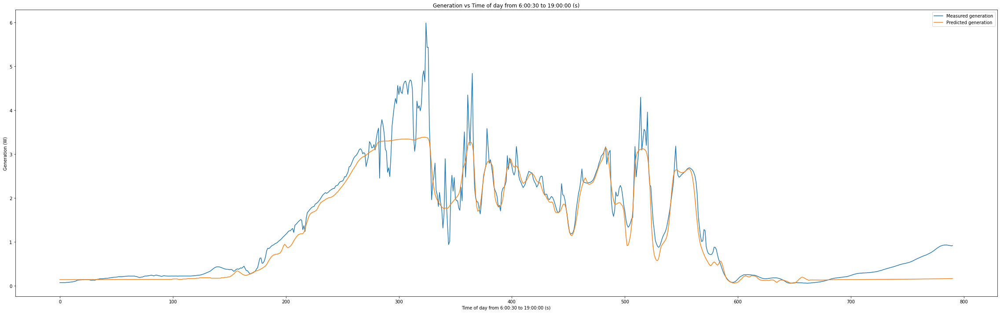

0.35627178662061576 0.05


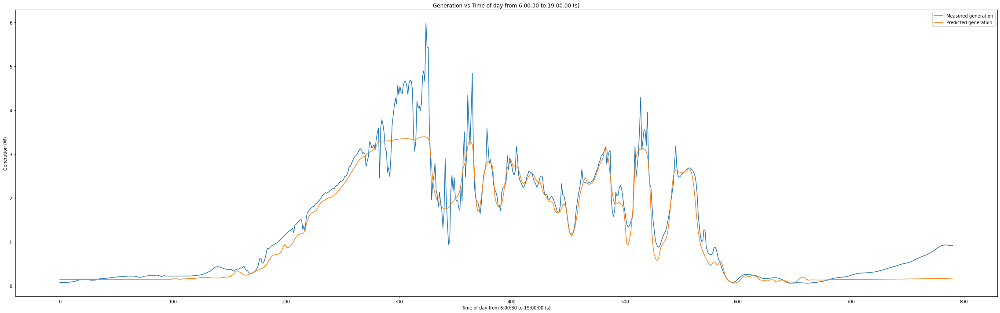

0.3544259773221463 0.06


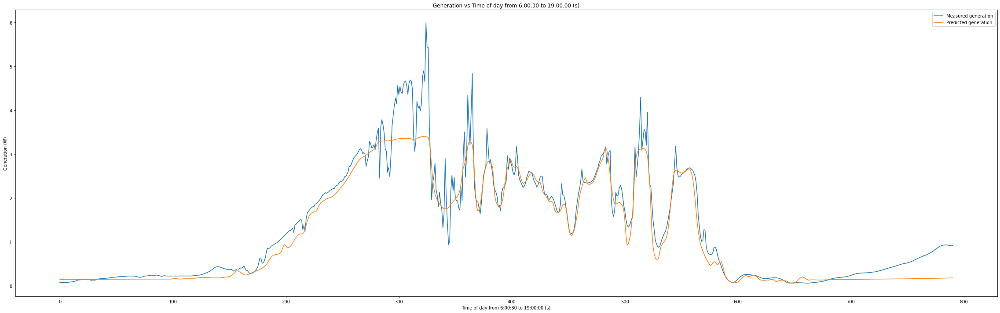

0.35259881013730043 0.07


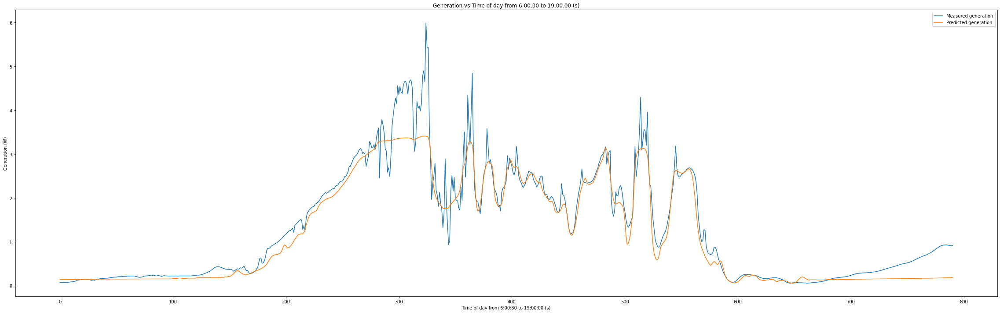

0.3507905763704192 0.08


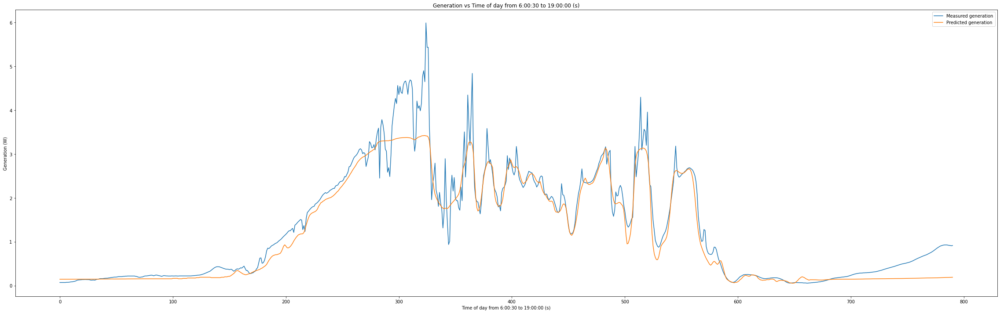

0.3490015703129576 0.09


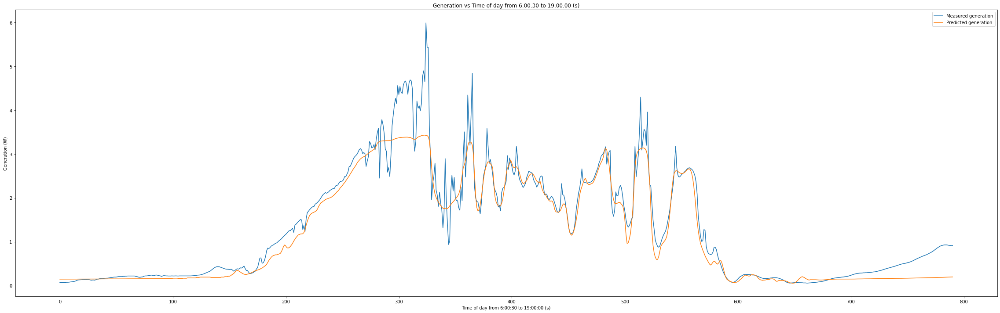

0.34723208915953996 0.1


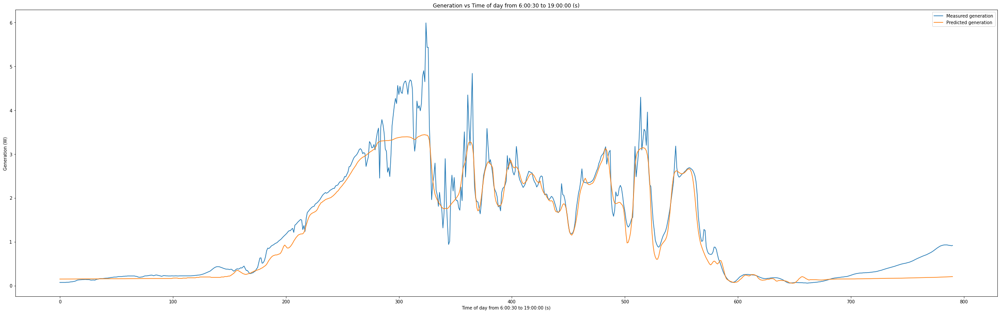

0.3454824329164302 0.11


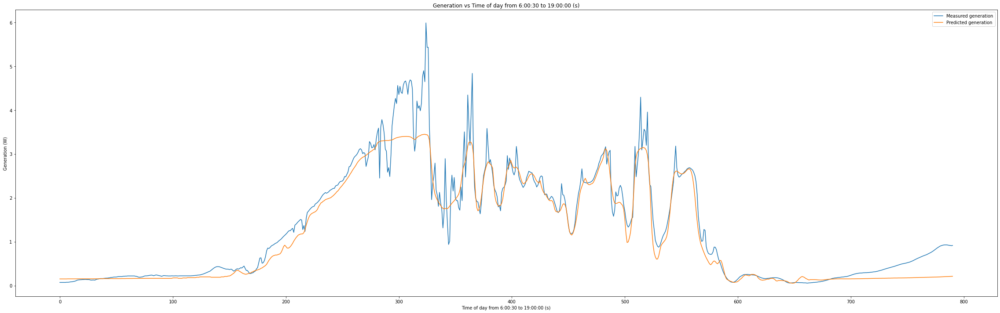

0.3437529043021775 0.12


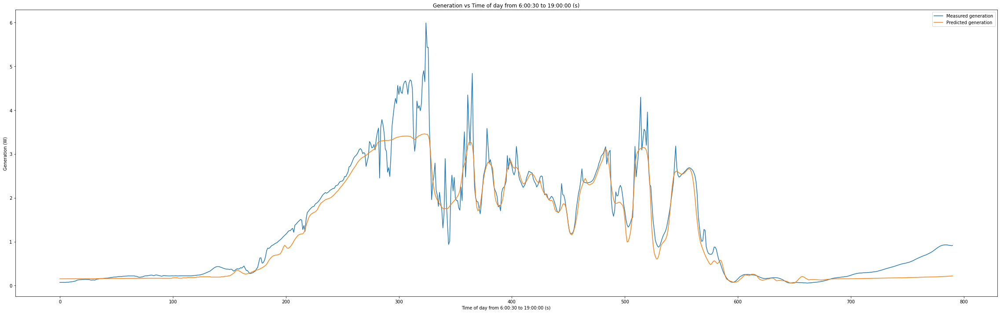

0.3420438086401757 0.13


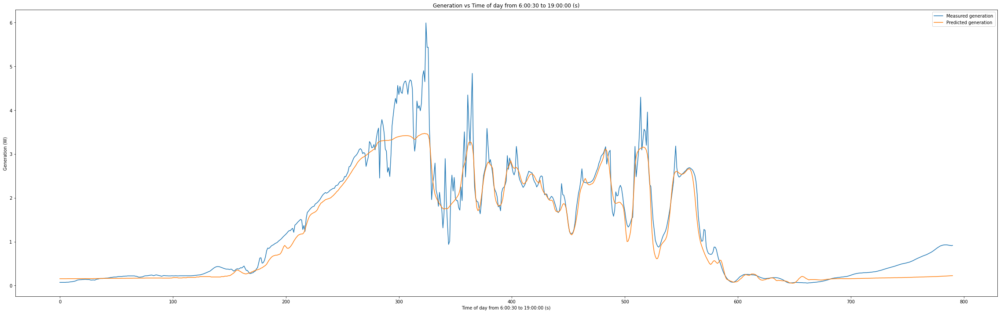

0.34035545374290876 0.14


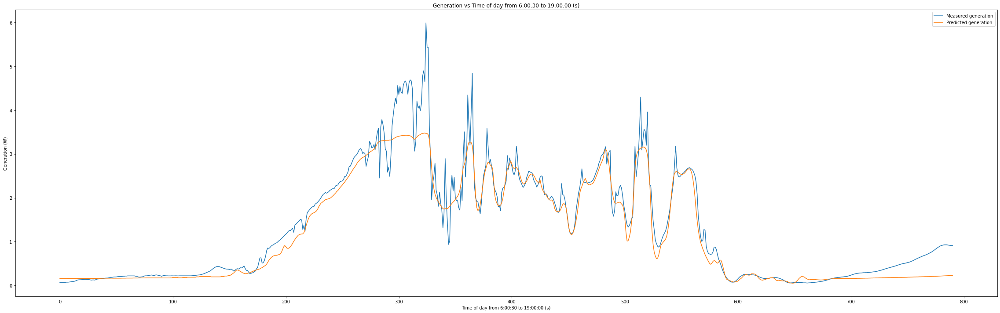

0.3386881497876384 0.15


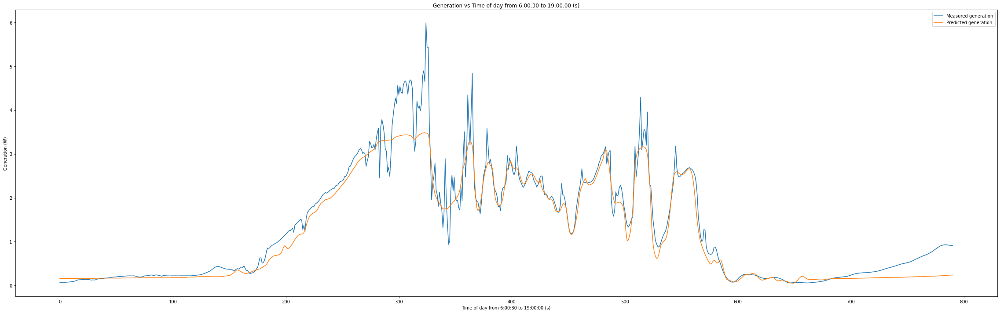

0.3370422091833243 0.16


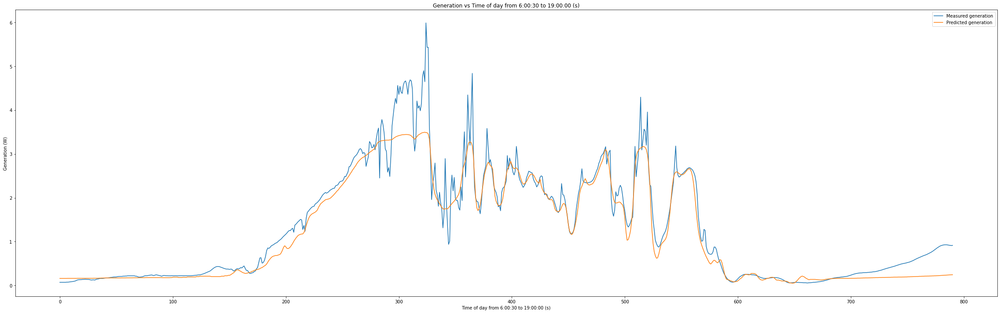

0.3354179464285511 0.17


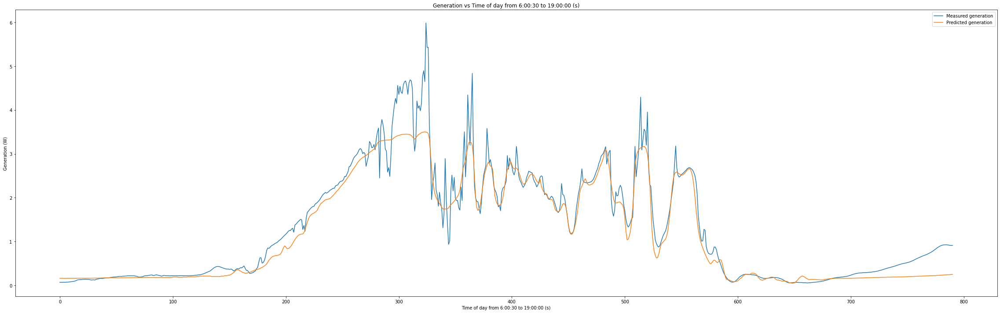

0.333815677960287 0.18


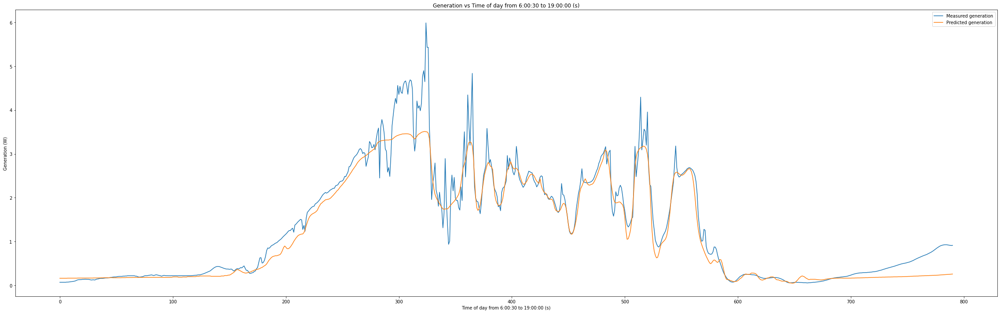

0.33223572199327756 0.19


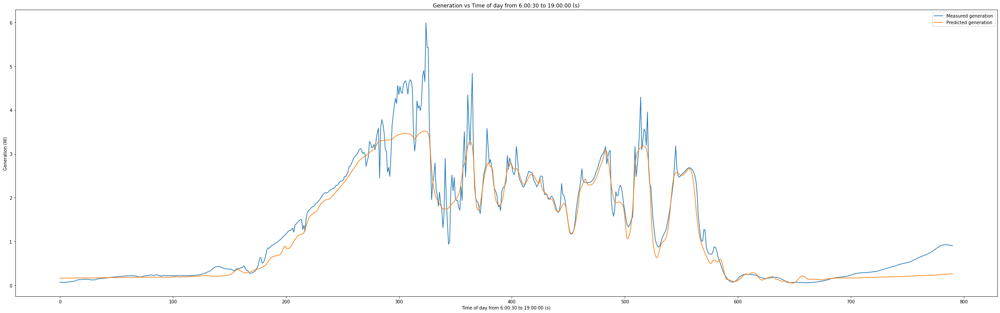

0.33067839834992524 0.2


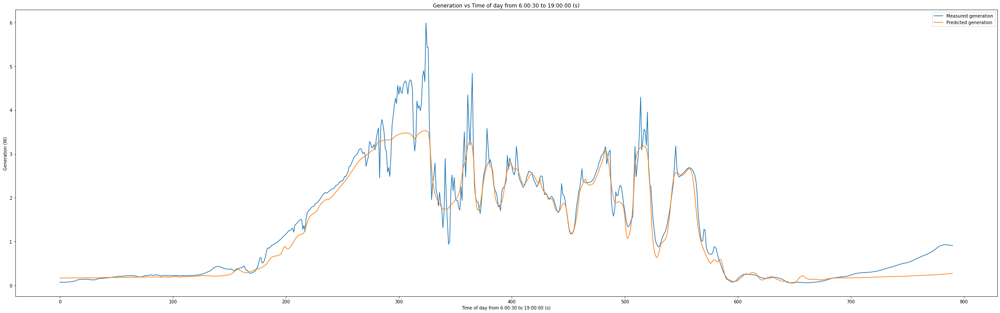

0.32914402828050526 0.21


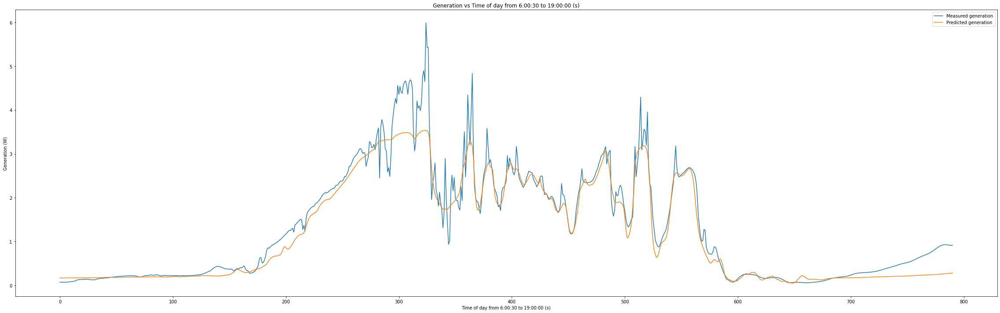

0.3276329342736065 0.22


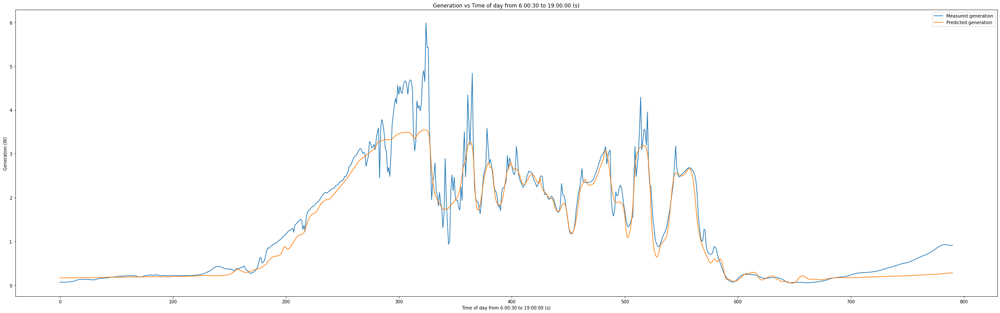

0.32614543985669536 0.23


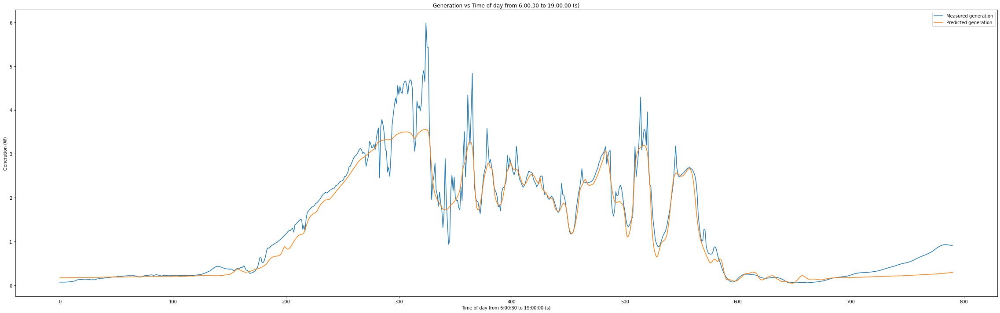

0.32468186938674337 0.24


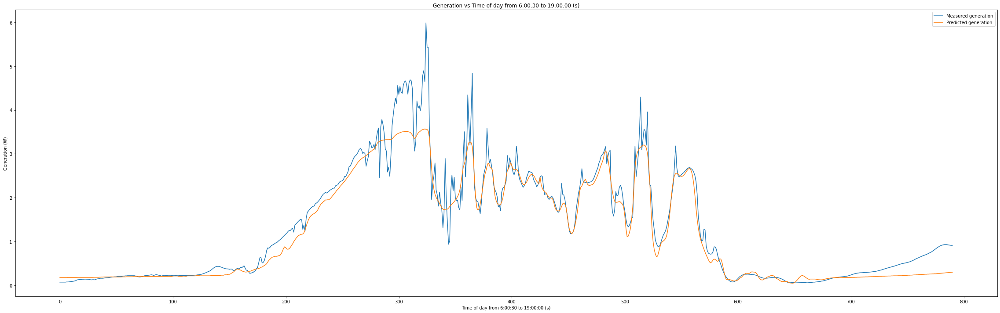

0.32324254783086975 0.25


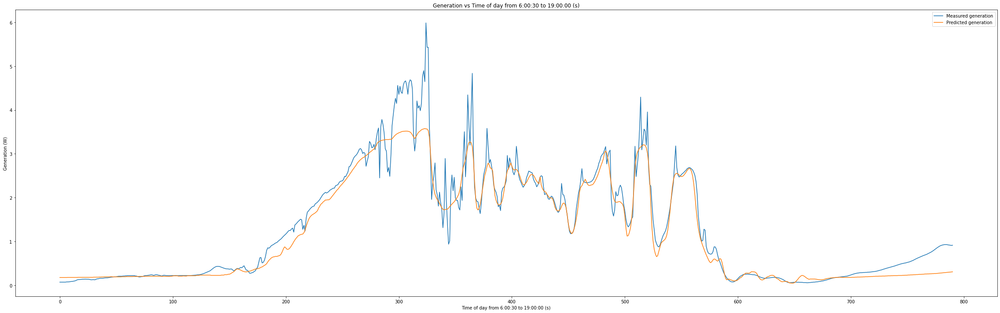

0.3218278005369999 0.26


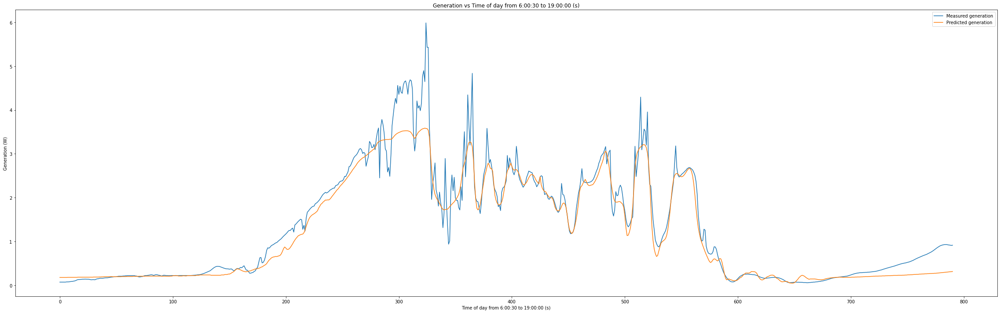

0.3204379529945584 0.27


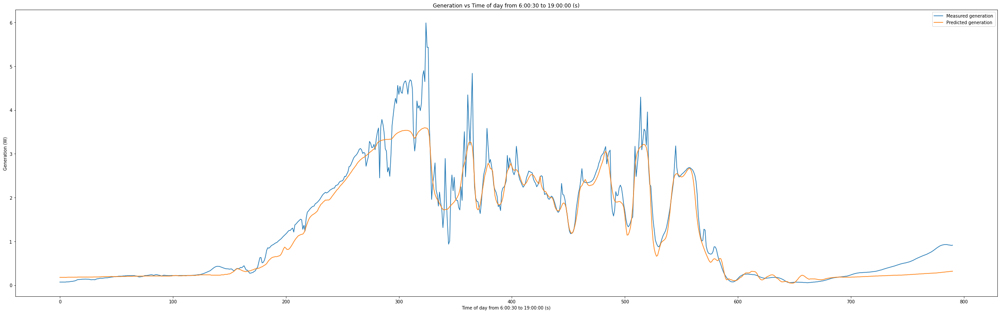

0.31907333058526116 0.28


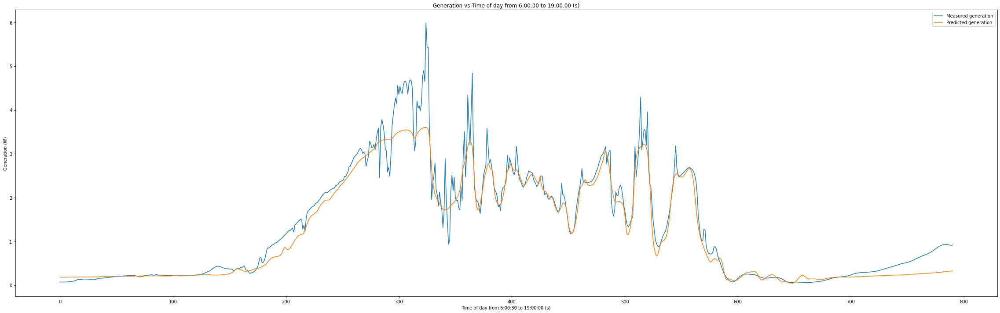

0.3177342583241042 0.29


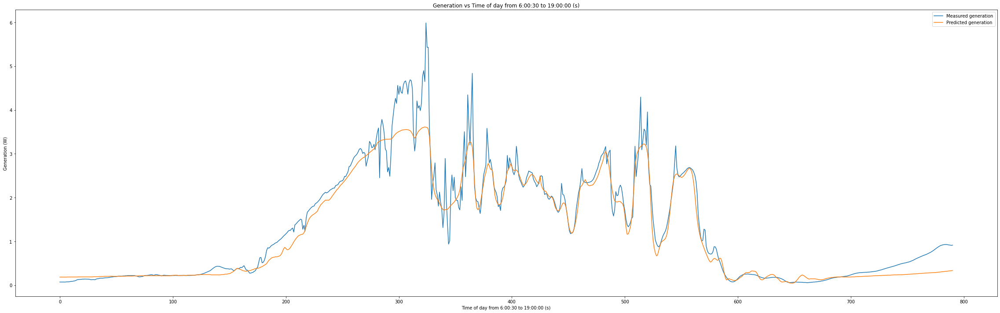

0.3164210605906869 0.3


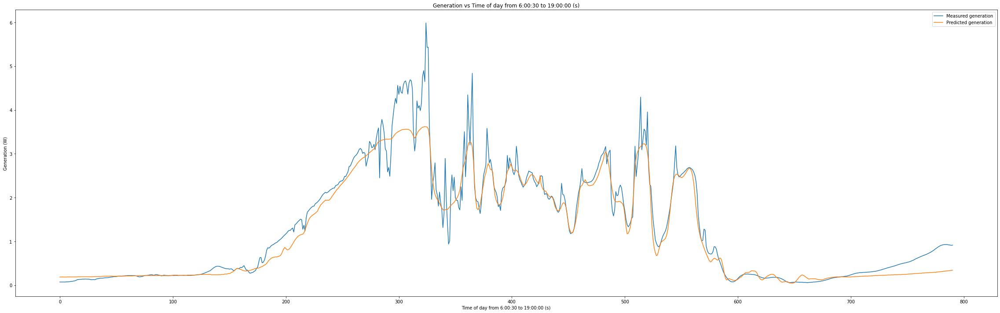

0.3151340608510451 0.31


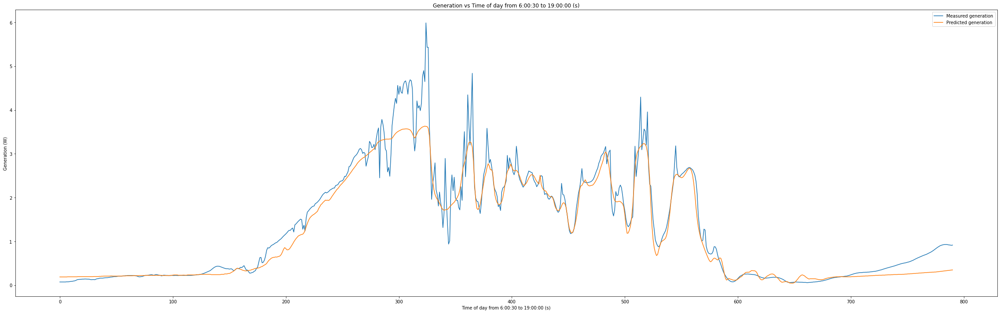

0.3138735813702302 0.32


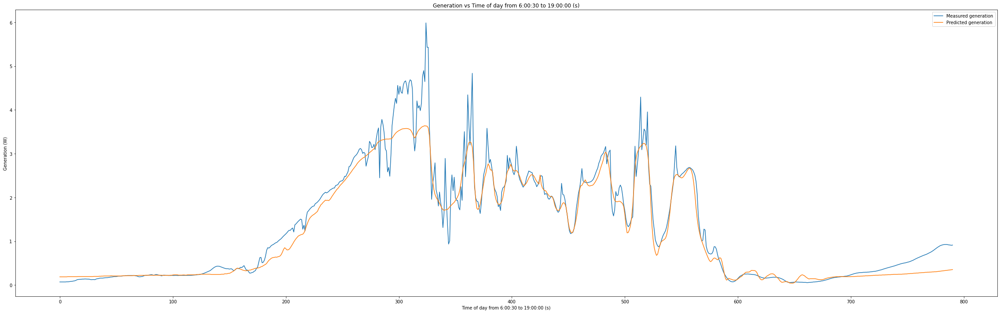

0.3126399429158845 0.33


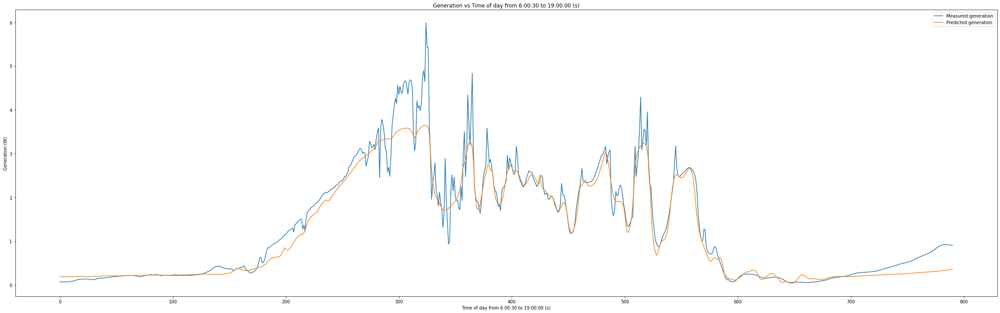

0.3114334644531469 0.34


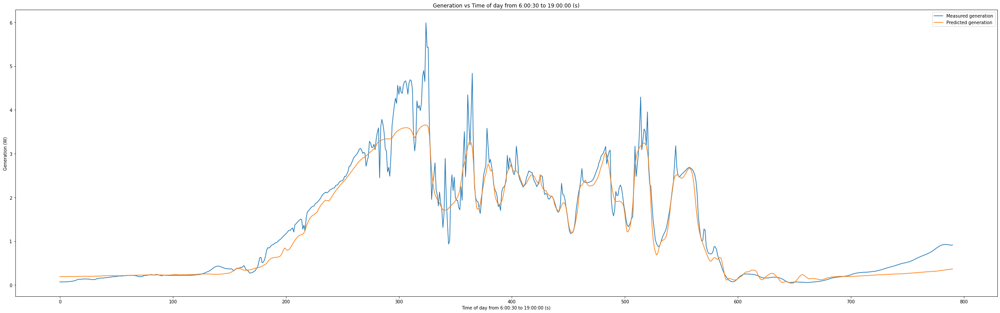

0.3102544628312384 0.35


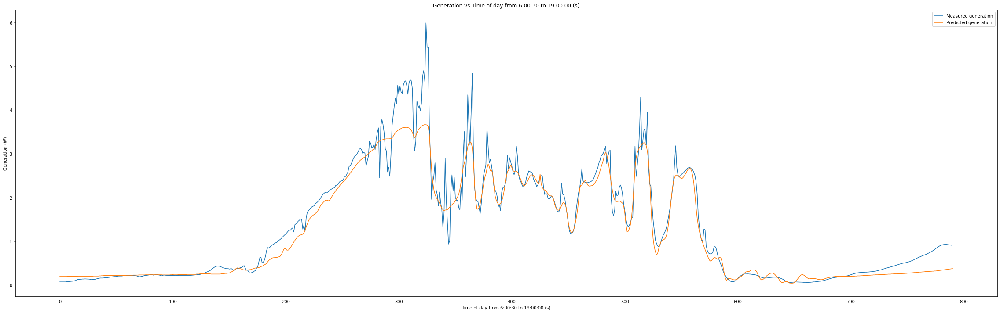

0.3091032524621508 0.36


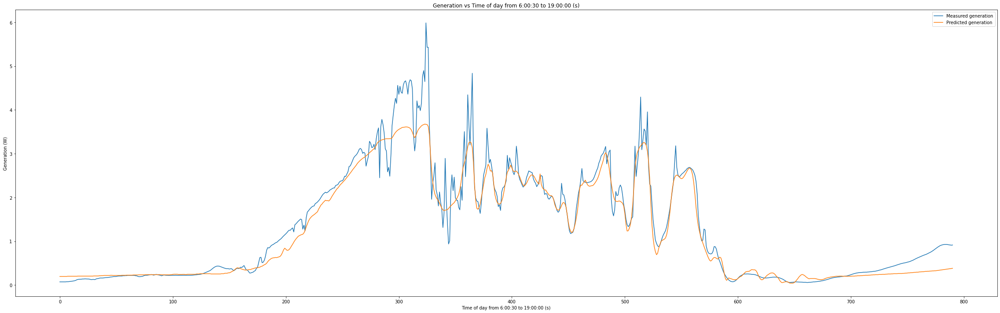

0.3079801449918954 0.37


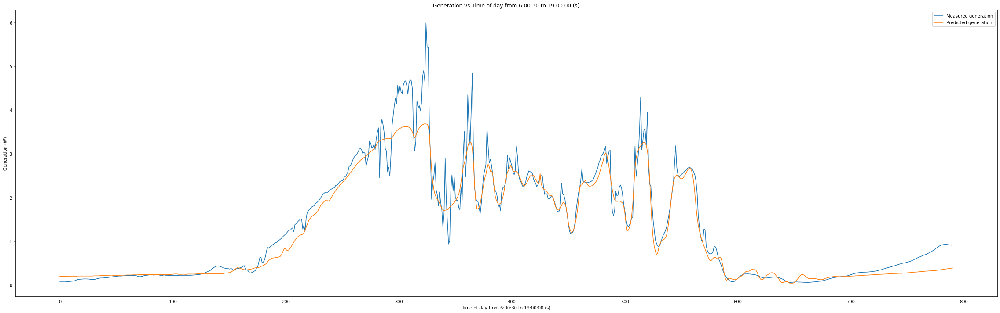

0.30688544896483194 0.38


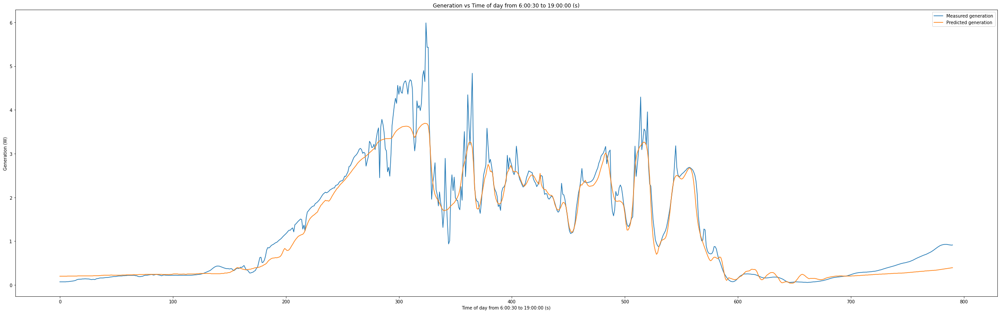

0.3058194694816418 0.39


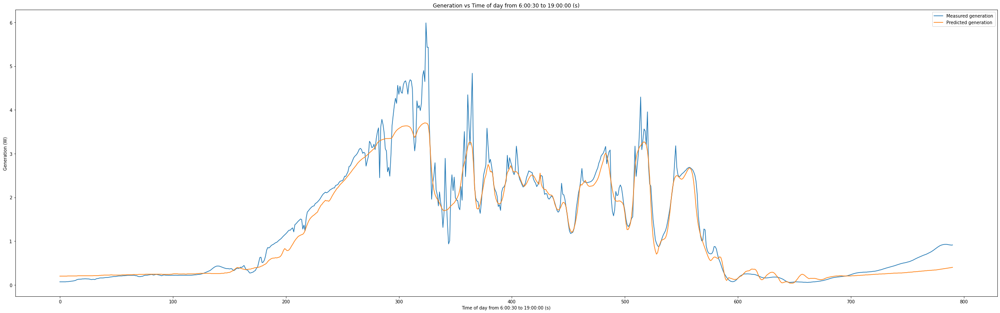

0.3047825078515637 0.4


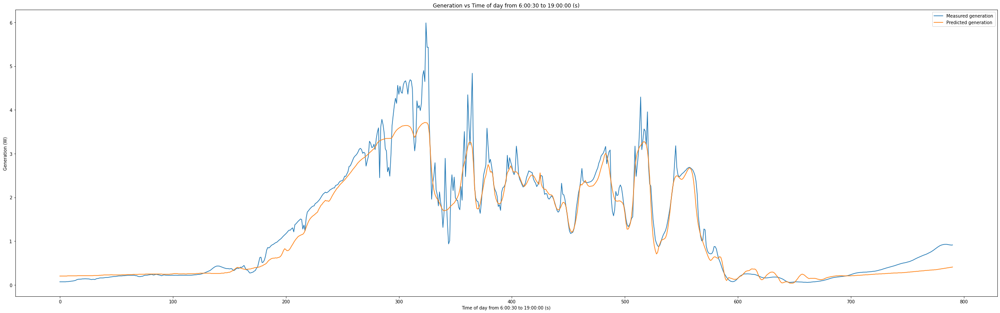

0.30377486123955766 0.41


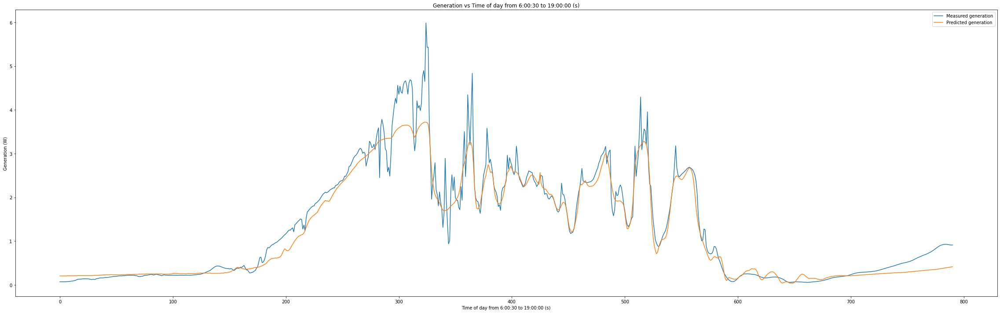

0.3027968223091279 0.42


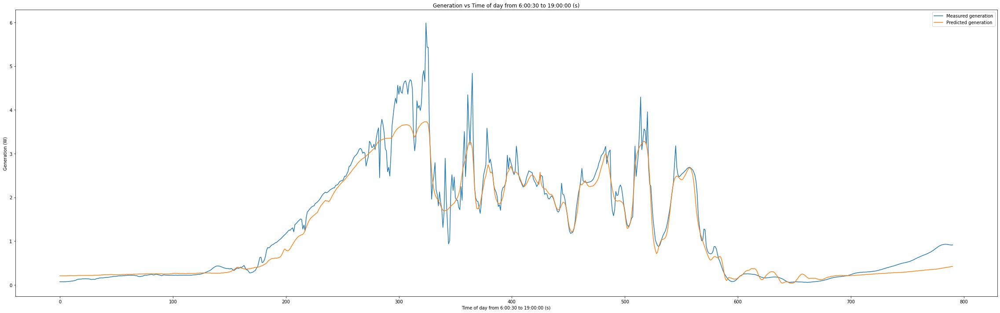

0.3018486788615575 0.43


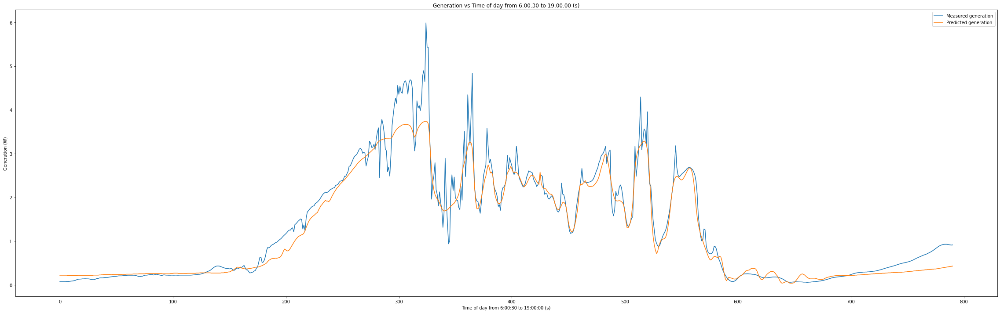

0.30093071347238515 0.44


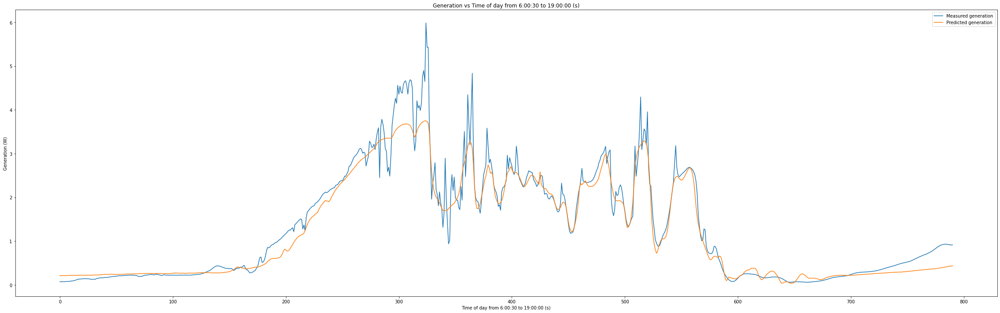

0.30004320312598076 0.45


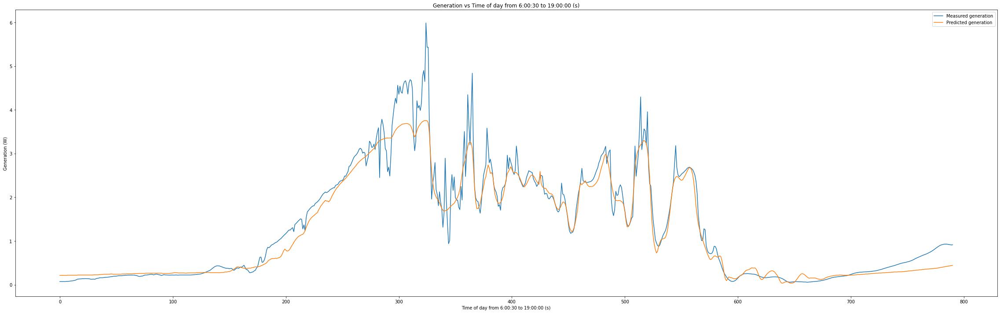

0.29918641884913055 0.46


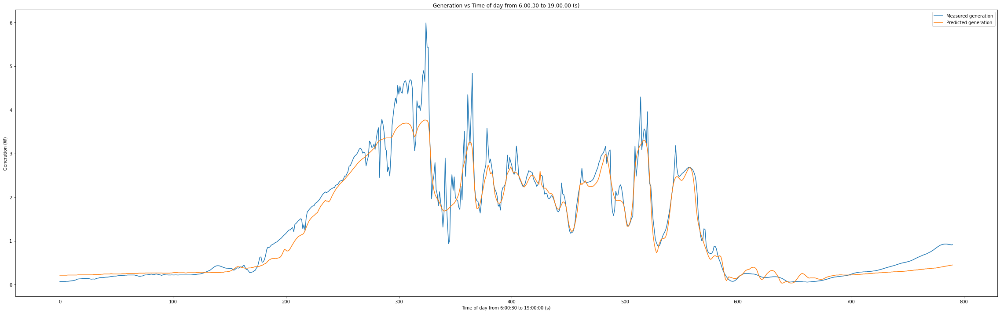

0.2983606253445737 0.47


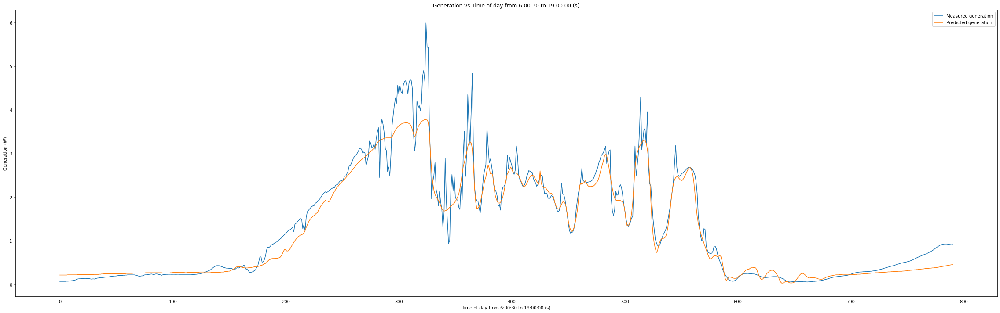

0.2975660806254835 0.48


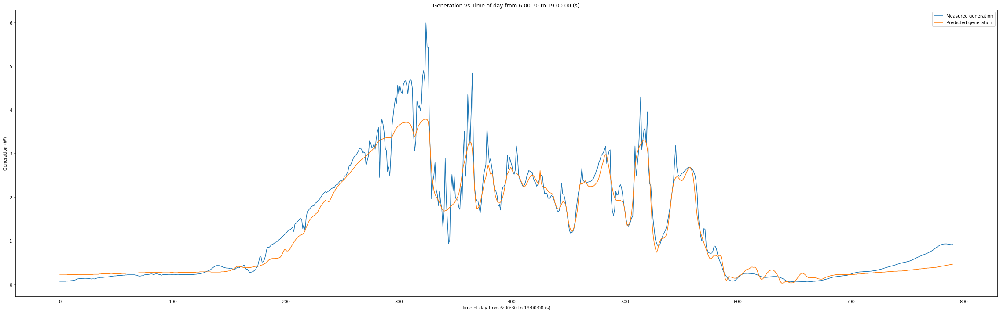

0.29680303565190697 0.49


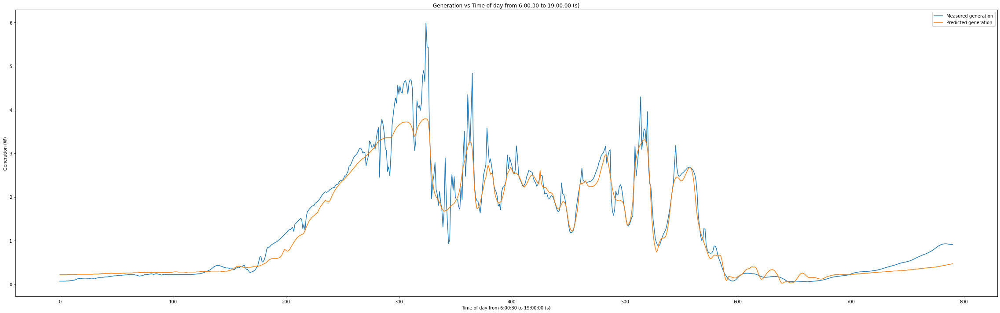

0.29607173397021774 0.5


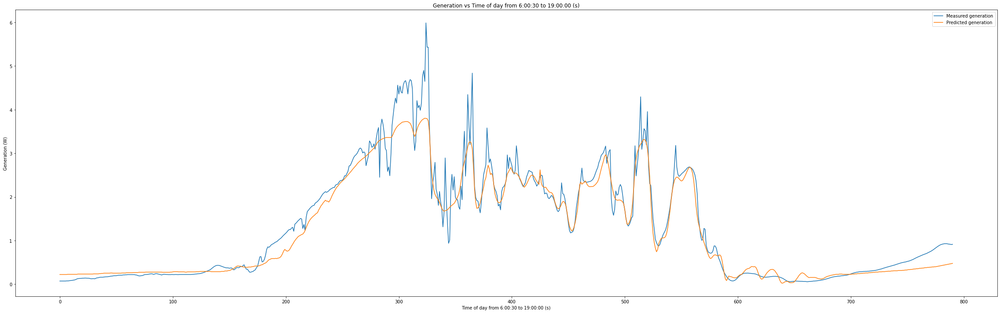

0.29537241135665454 0.51


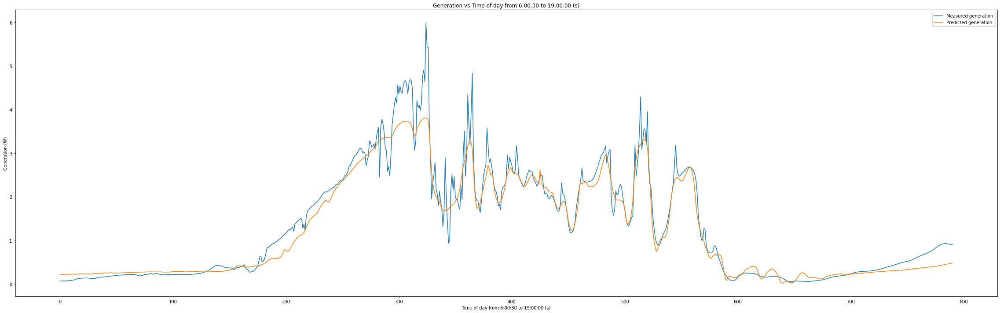

0.29470529546604185 0.52


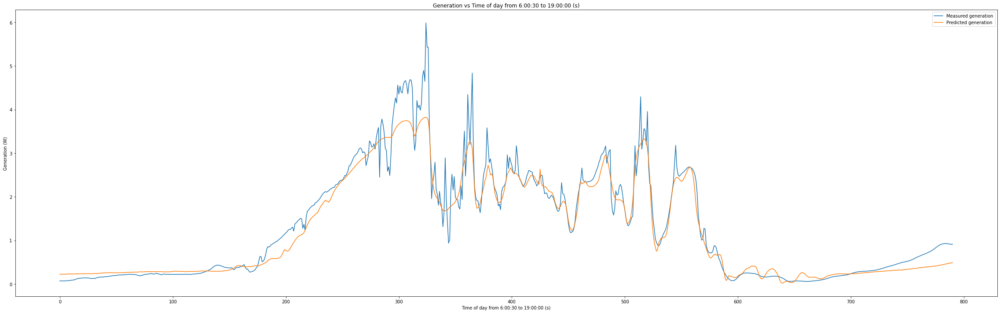

0.2940706054868082 0.53


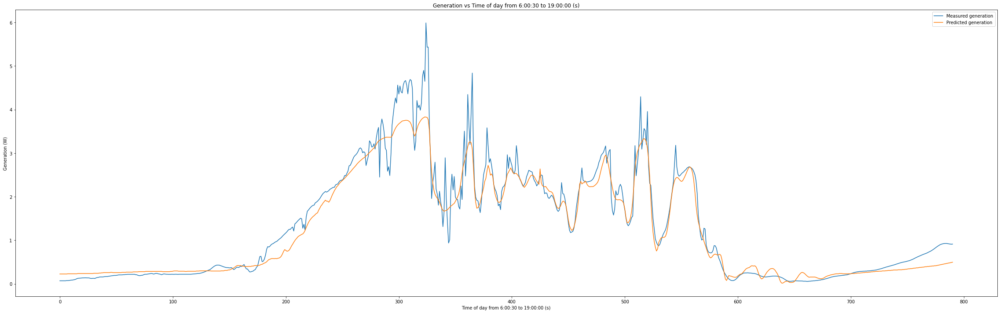

0.2934685518034224 0.54


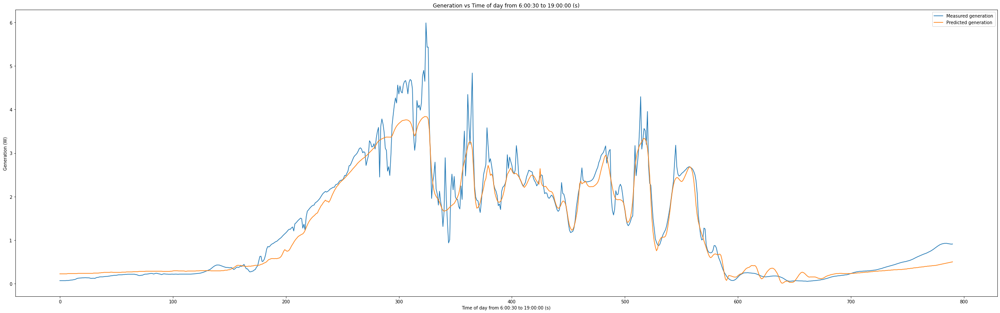

0.2928993356673704 0.55


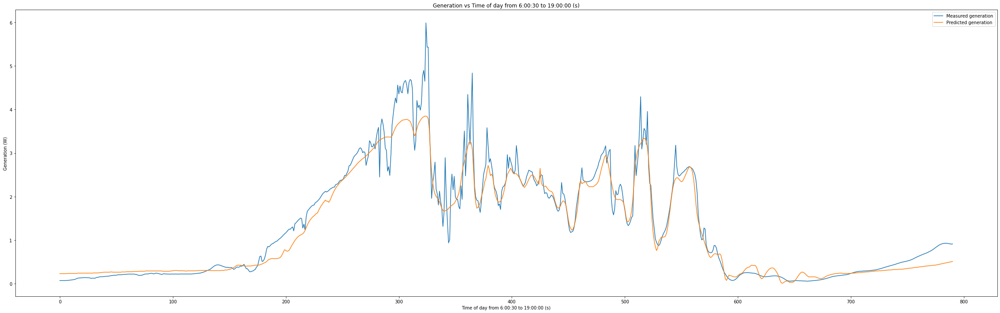

0.29236314887780346 0.56


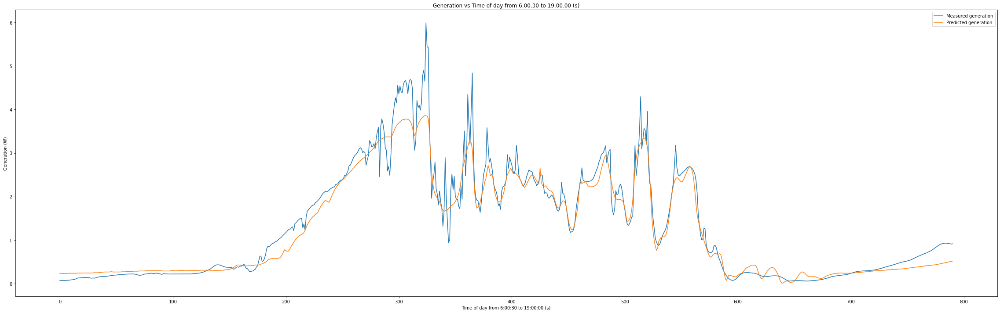

0.2918601734729685 0.57


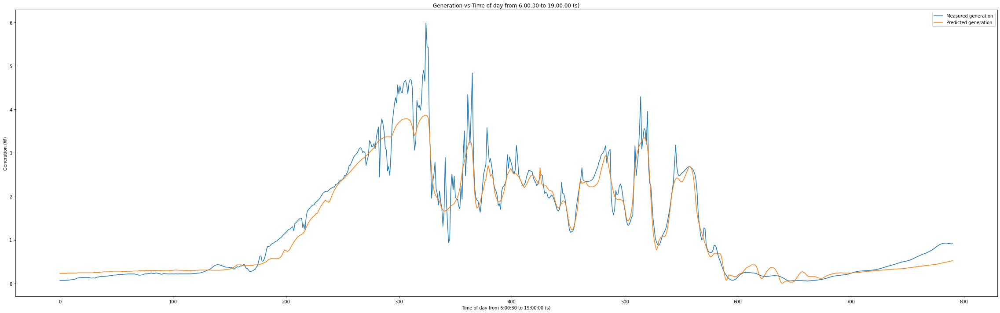

0.29139058143352353 0.58


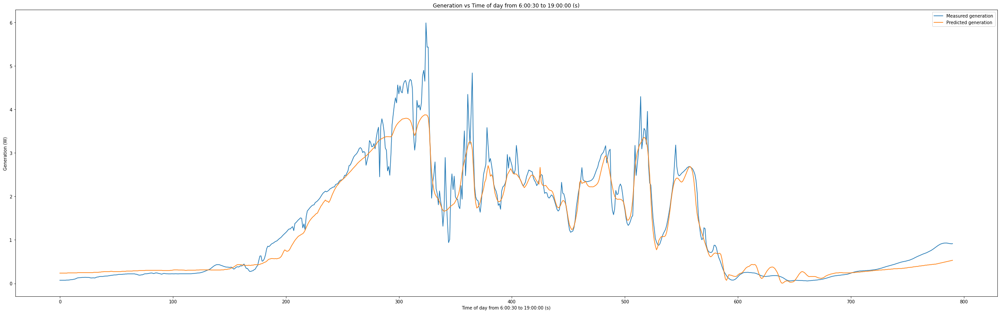

0.2909545343988151 0.59


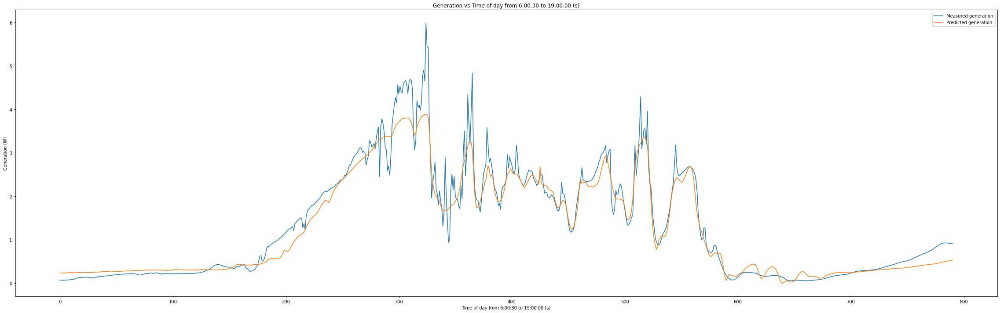

0.2905521833971736 0.6


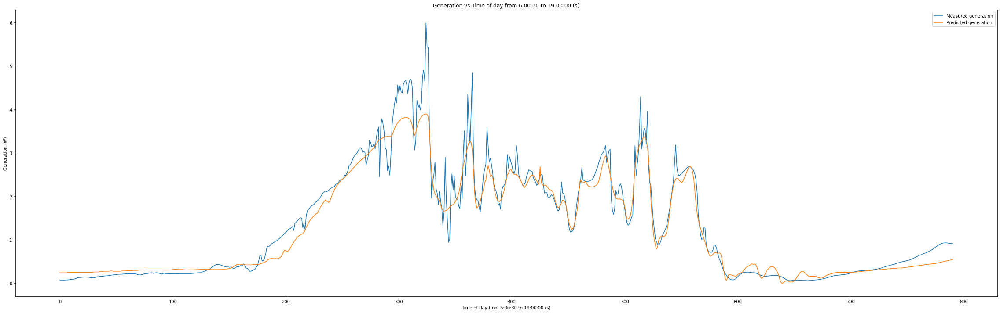

0.29018366859123385 0.61


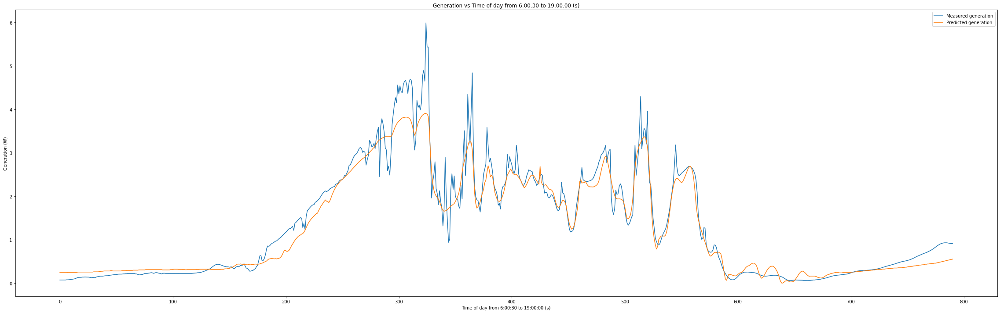

0.2898491190392653 0.62


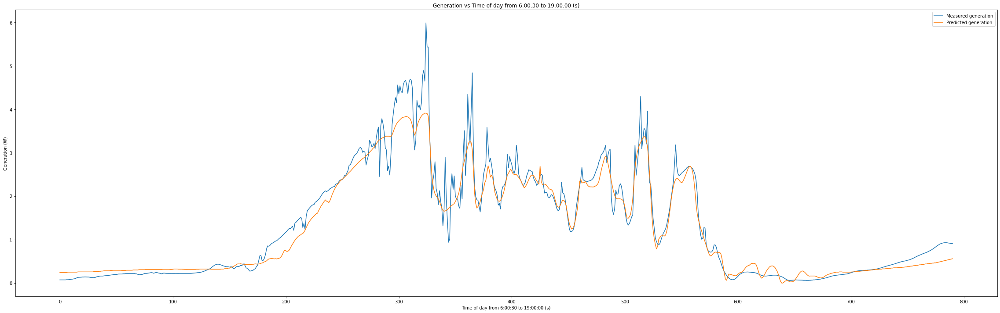

0.28954865247342837 0.63


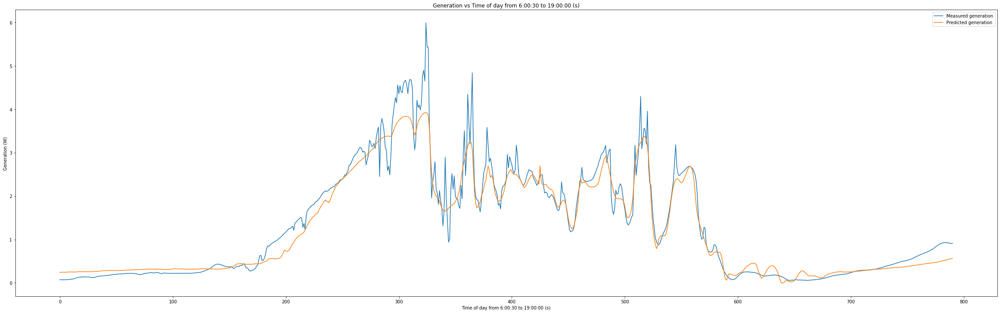

0.2892823750958347 0.64


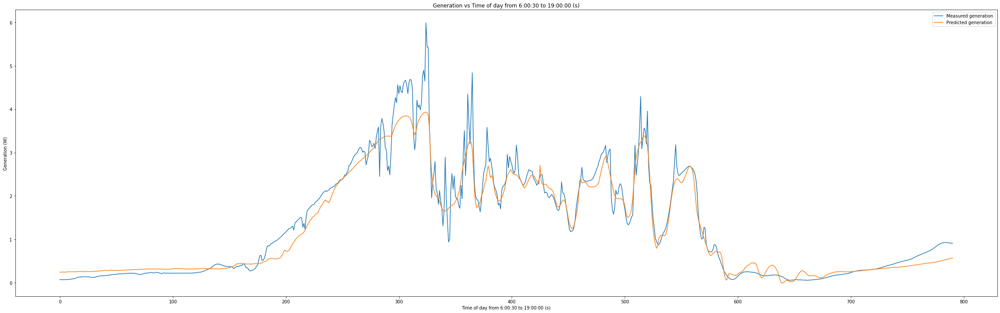

0.28905038139321865 0.65


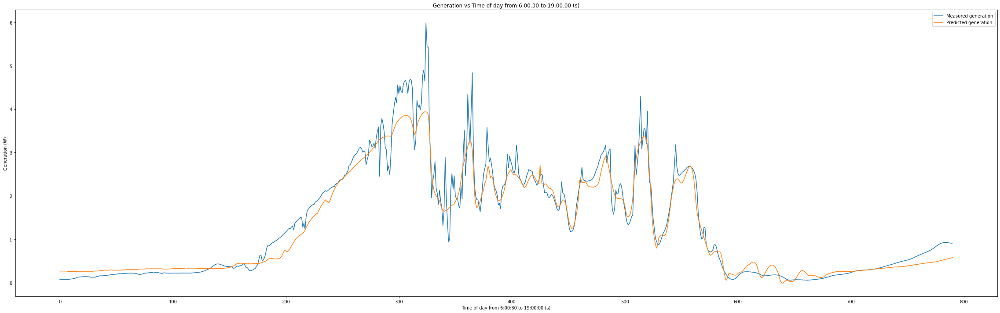

0.2888527539709671 0.66


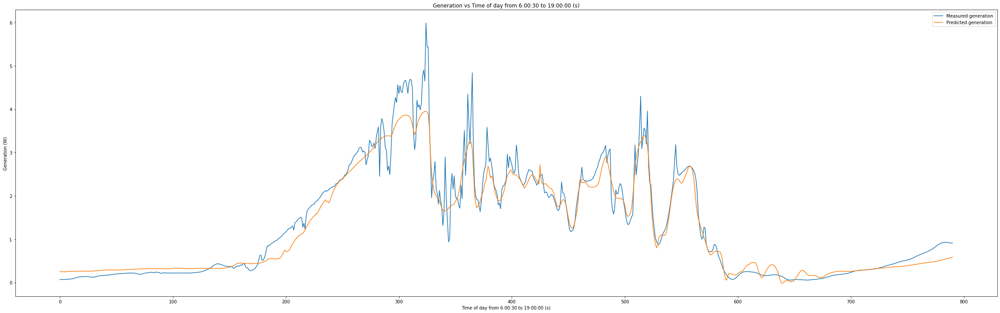

0.28868956340717894 0.67


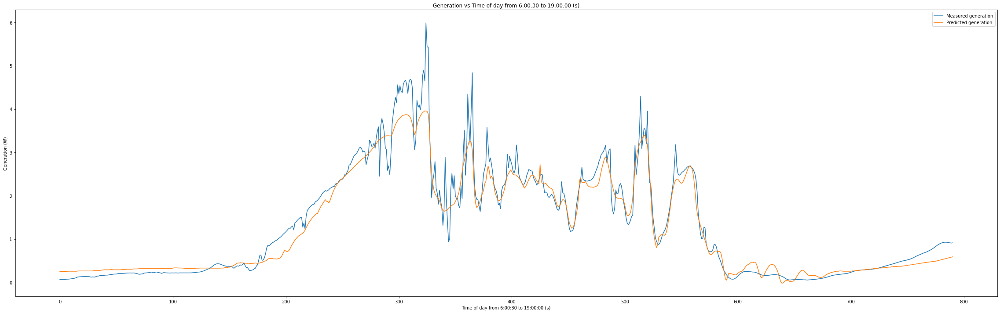

0.28856086812735393 0.68


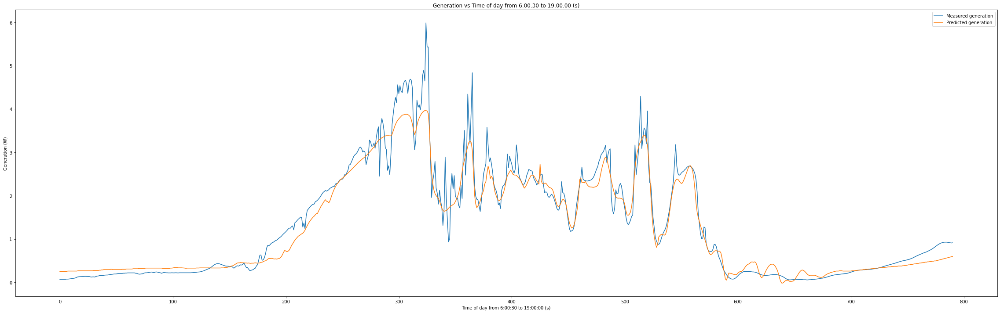

0.2884667143002215 0.69


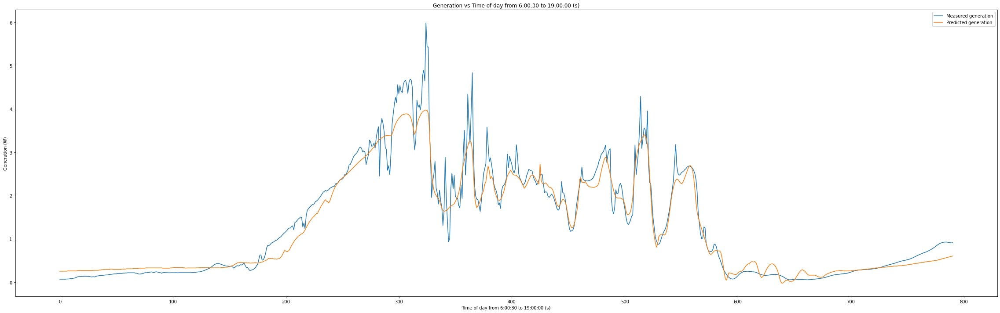

0.2884071357551475 0.7


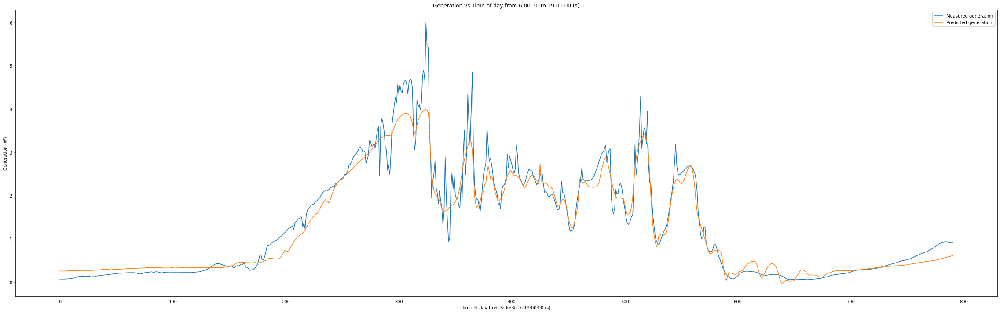

0.2883821539214576 0.71


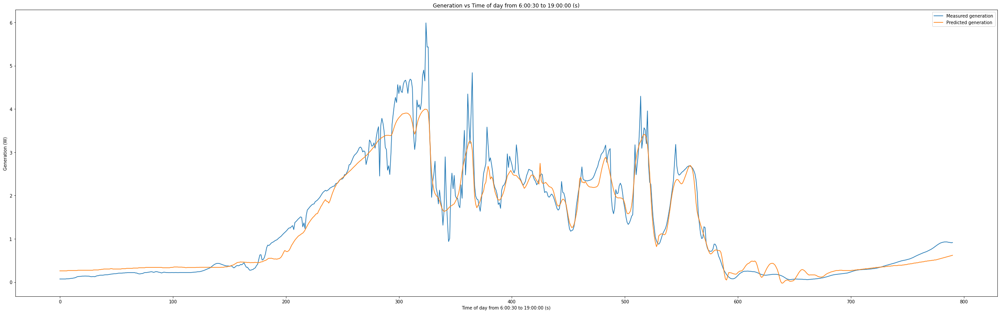

0.28839177778993536 0.72


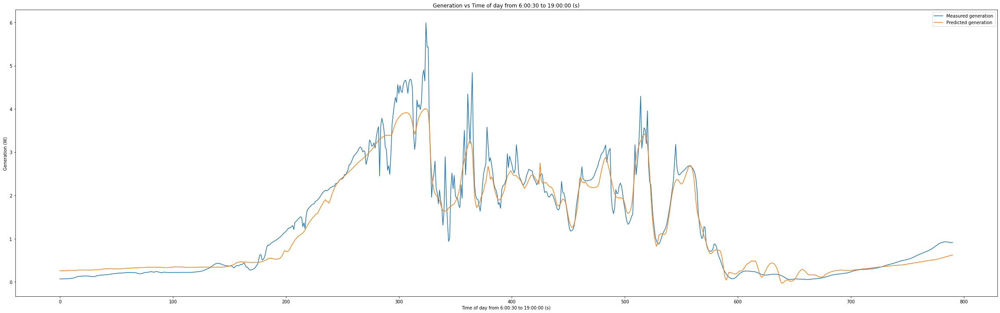

0.28843600389665036 0.73


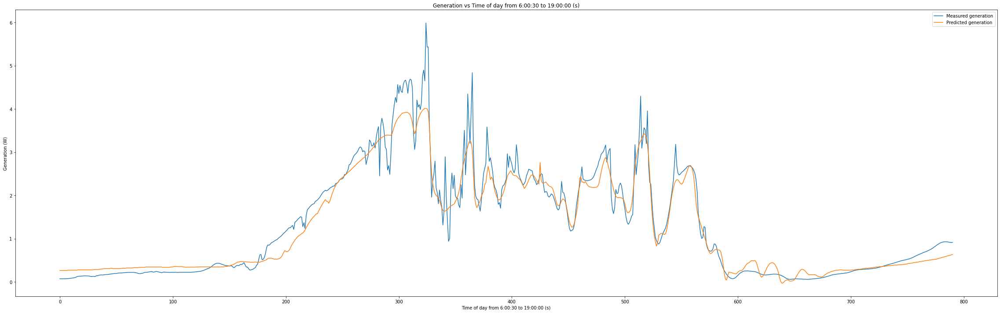

0.28851481632919074 0.74


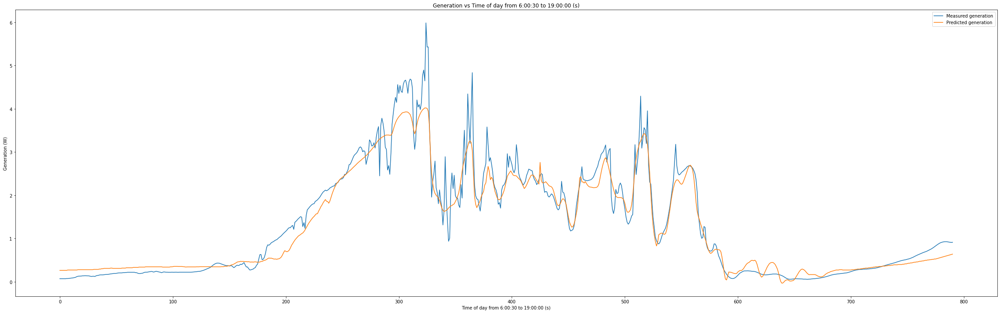

0.2886281867552672 0.75


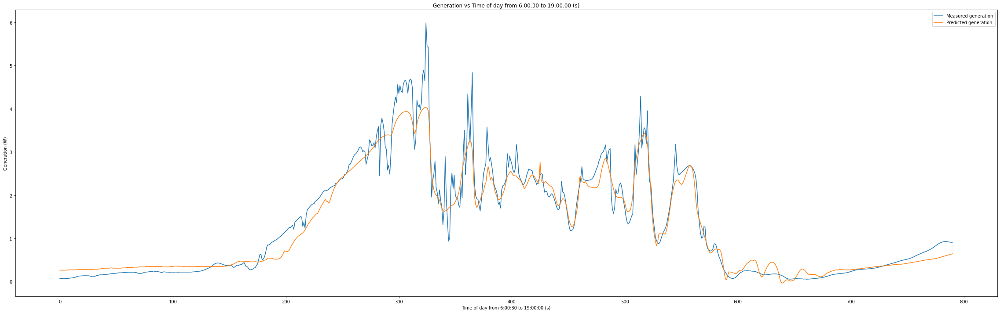

0.28877607447357756 0.76


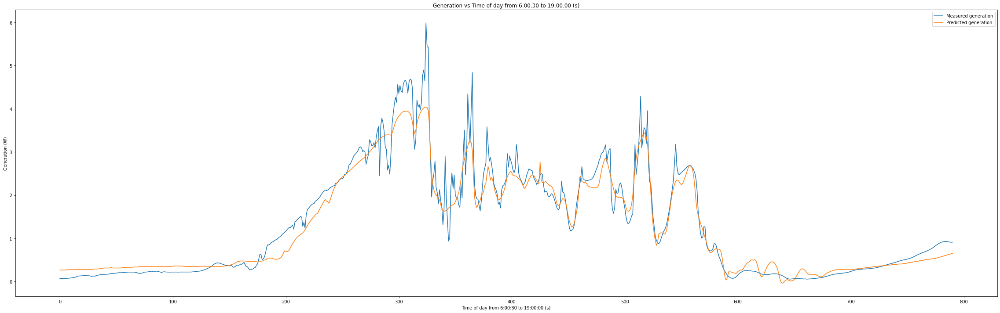

0.2889584264867073 0.77


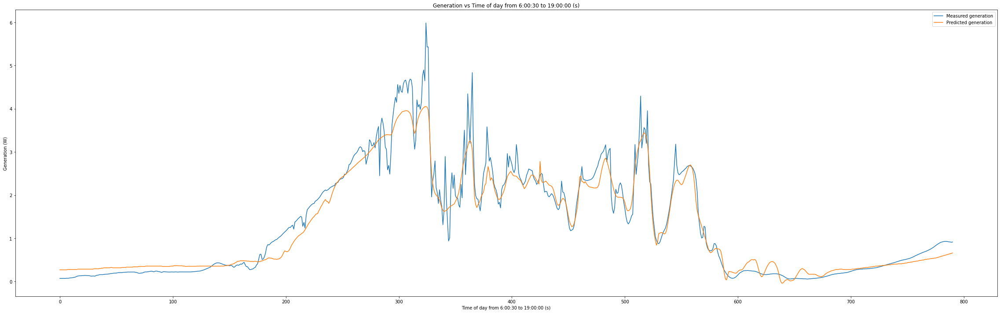

0.289175177595774 0.78


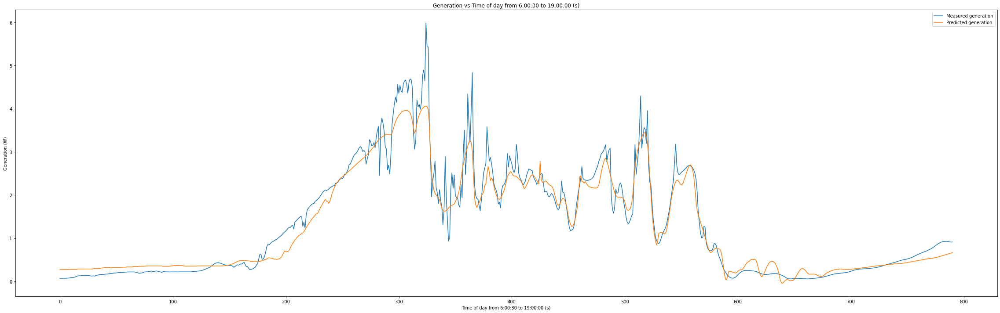

0.2894262505164136 0.79


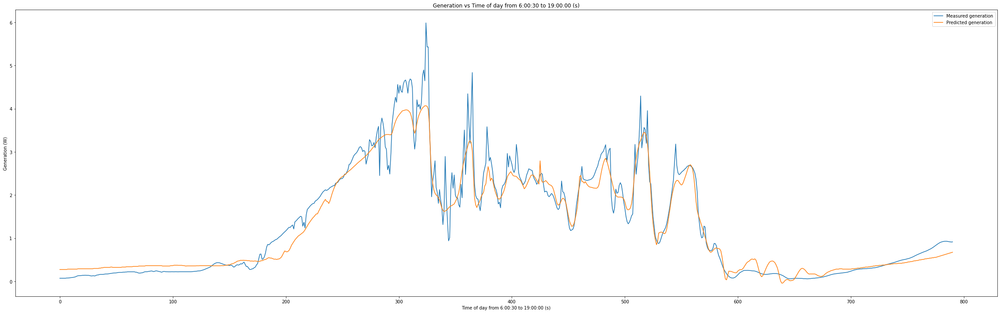

0.28971155601563664 0.8


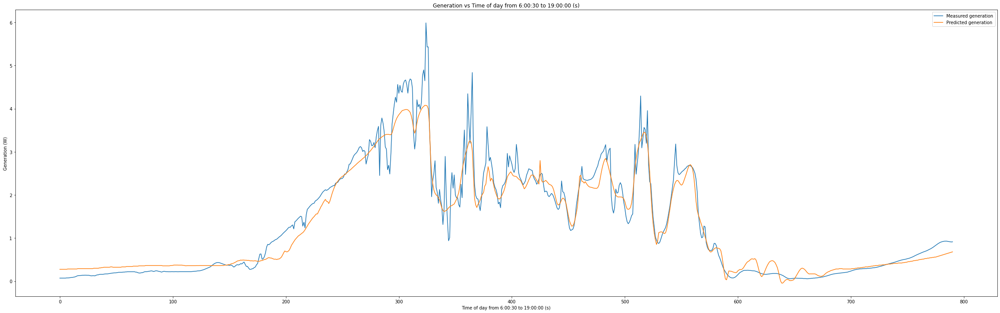

0.2900309930689848 0.81


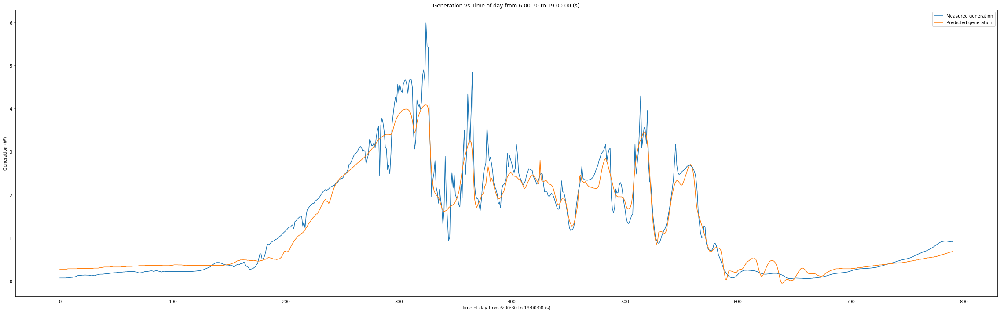

0.2903844490373592 0.82


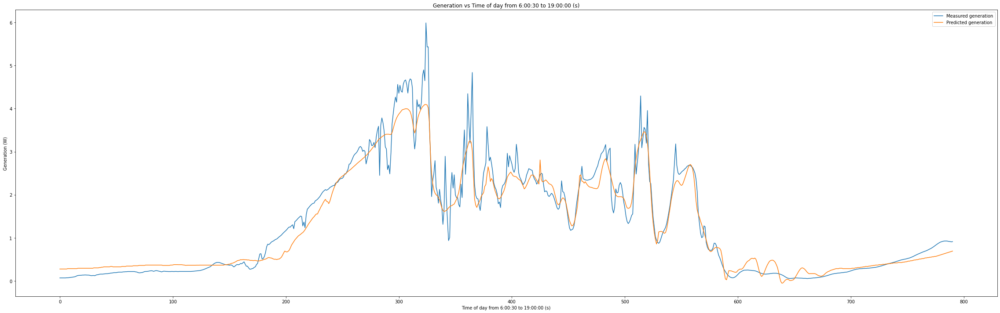

0.2907717998627941 0.83


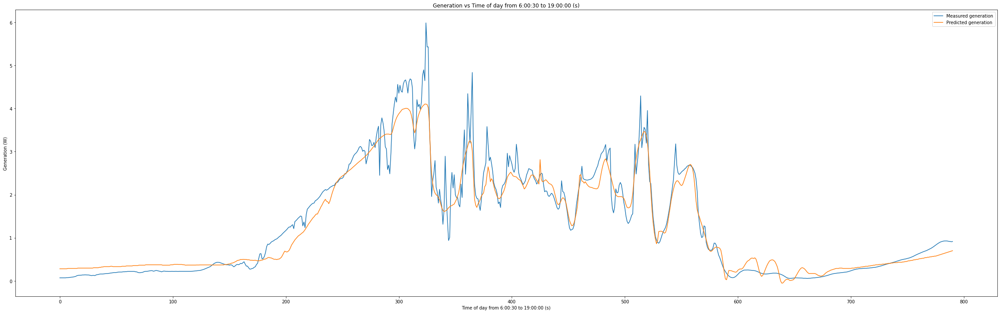

0.2911929102824034 0.84


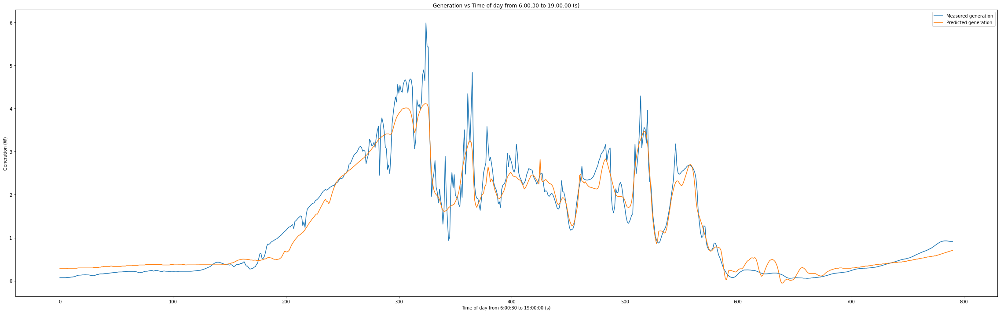

0.29164763405965005 0.85


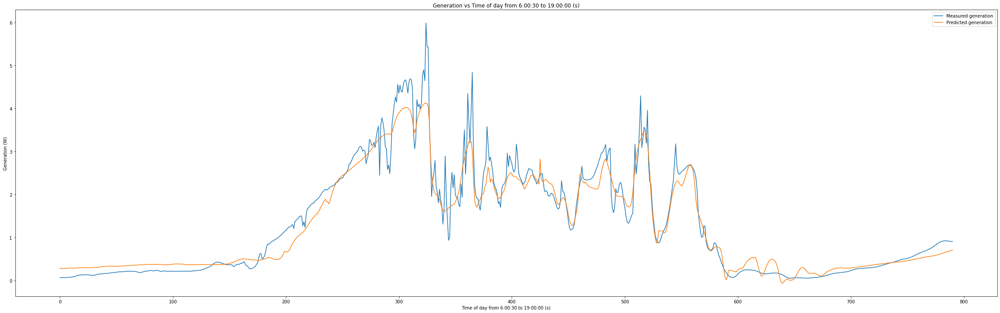

0.2921358142320391 0.86


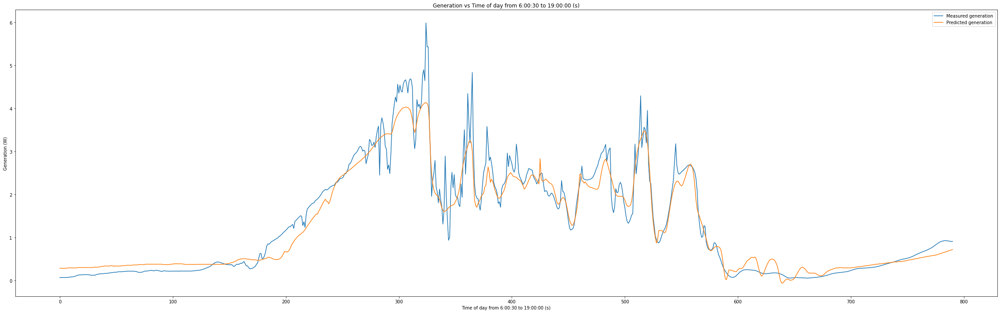

0.292657283374274 0.87


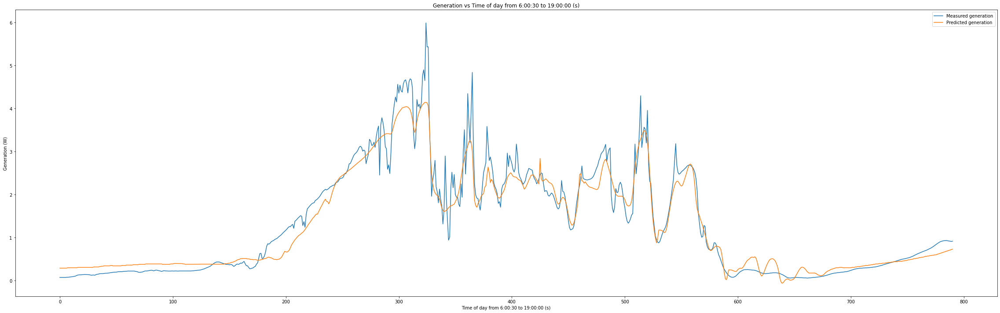

0.2932118638758888 0.88


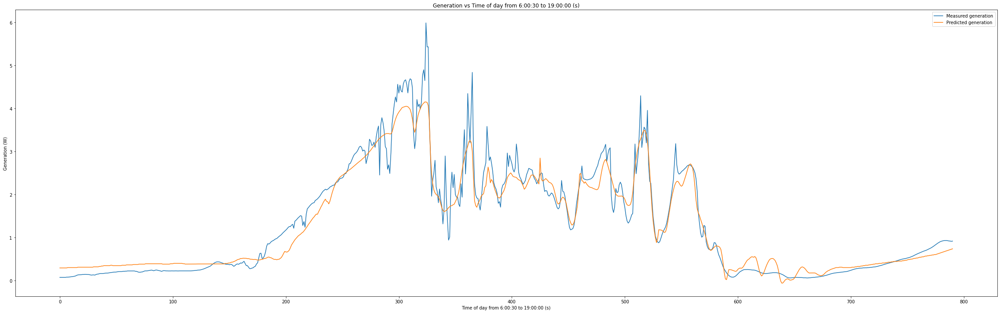

0.29379936823230973 0.89


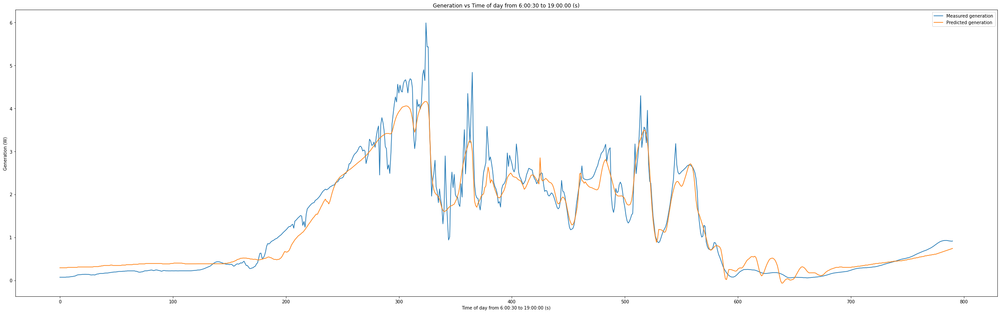

0.2944195993482847 0.9


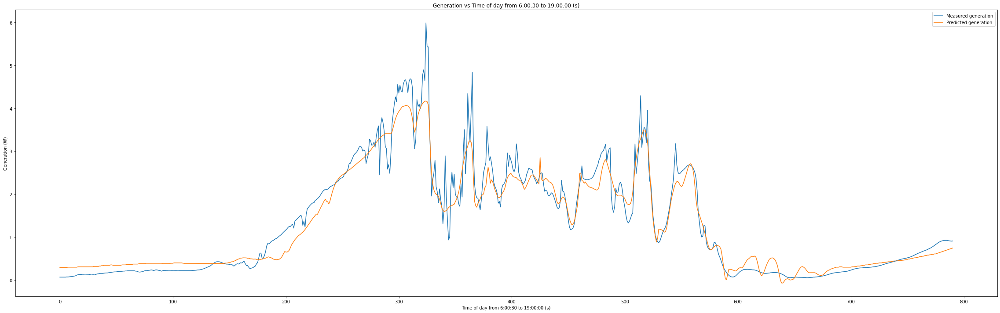

0.2950723508525898 0.91


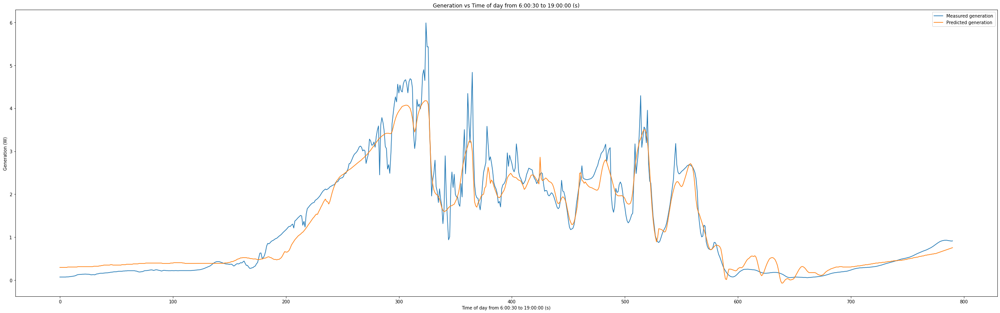

0.2957574074228947 0.92


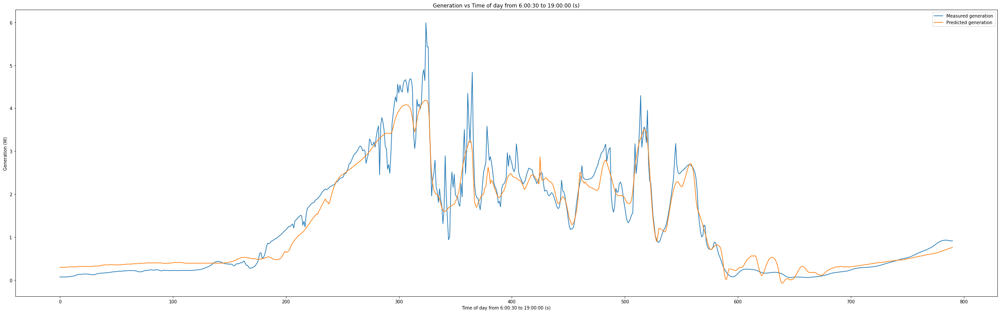

0.29647454511967664 0.93


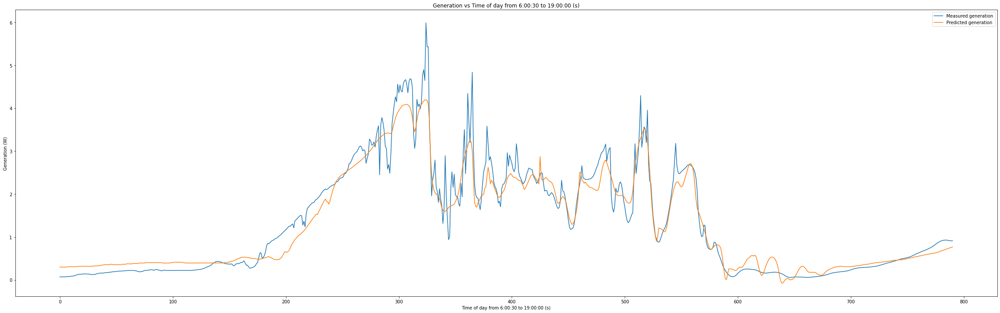

0.29722353172805027 0.94


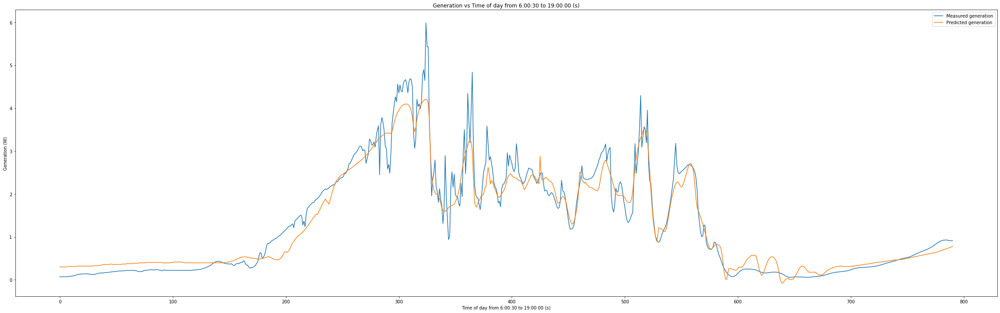

0.29800412710638735 0.95


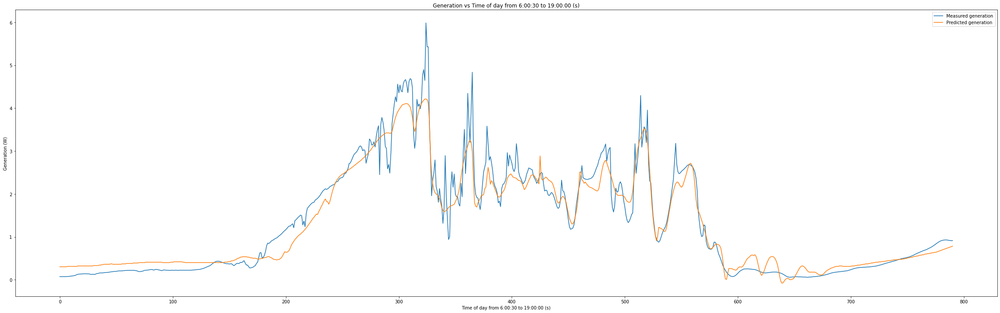

0.2988160835406183 0.96


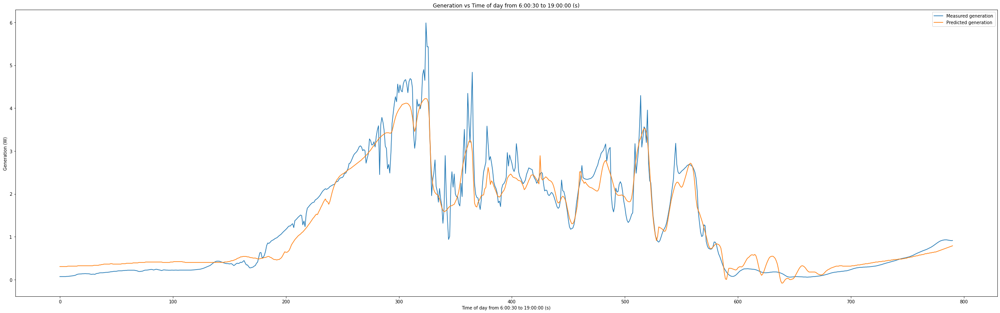

0.29965914610309585 0.97


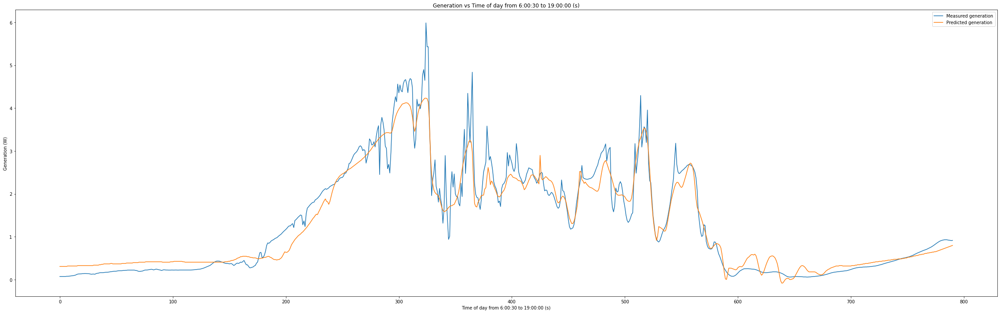

0.30053305301495215 0.98


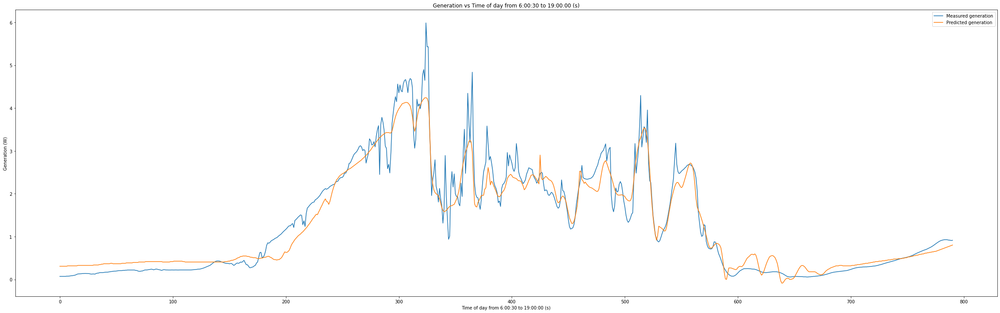

0.3014375360108764 0.99


In [ ]:
count = 0
for ensemble1 in ensemble:
  plt.figure(figsize=(40,12))
  #
  plt.plot( list(Expected1))
  plt.plot(ensemble1)
  #plt.plot(pred1)
  plt.title("Generation vs Time of day from 6:00:30 to 19:00:00 (s)")
  plt.ylabel("Generation (W)")
  plt.xlabel("Time of day from 6:00:30 to 19:00:00 (s)")
  plt.legend(('Measured generation','Predicted generation'))
  plt.show()
  print(RMSE[count], weights_list[count]/100)
  count +=1

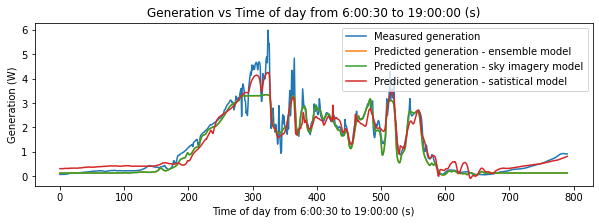

0.3657704873357274 0.0


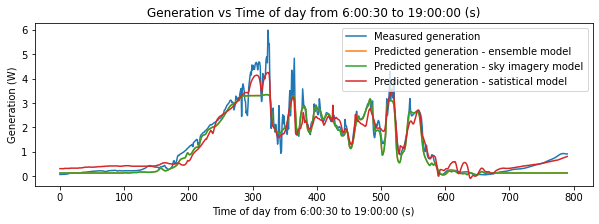

0.3638357275088358 0.01


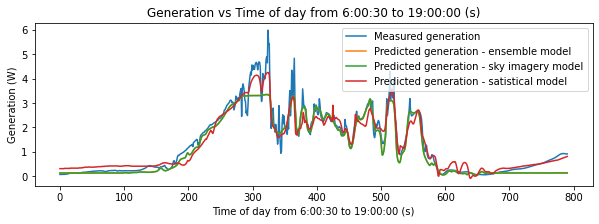

0.36191820052122414 0.02


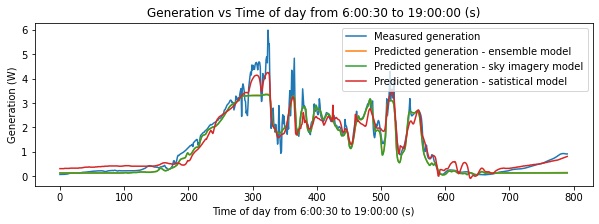

0.36001818172937733 0.03


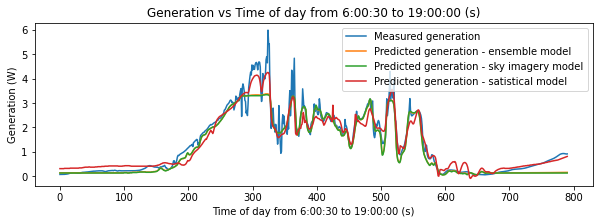

0.3581359497921174 0.04


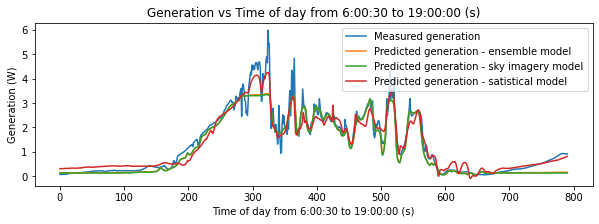

0.35627178662061576 0.05


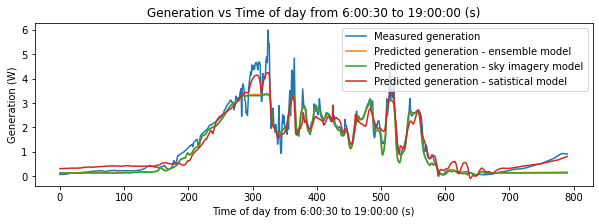

0.3544259773221463 0.06


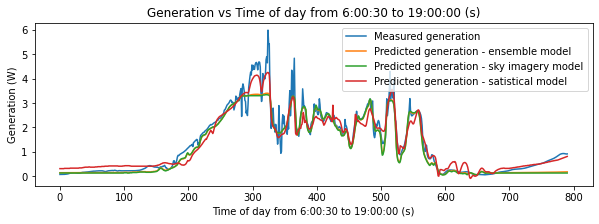

0.35259881013730043 0.07


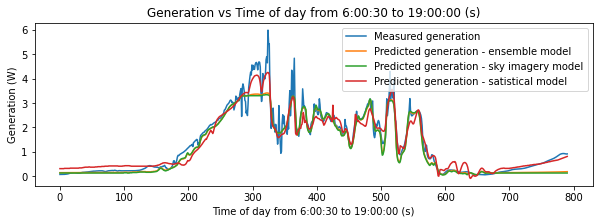

0.3507905763704192 0.08


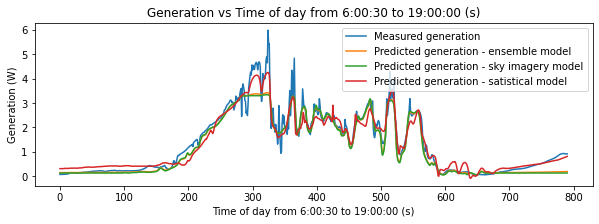

0.3490015703129576 0.09


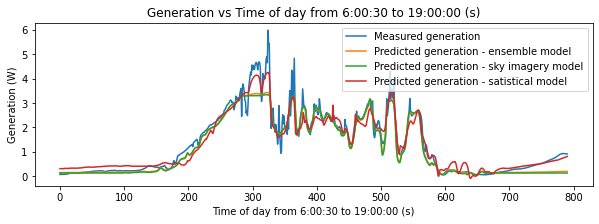

0.34723208915953996 0.1


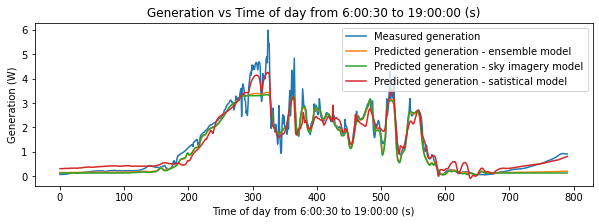

0.3454824329164302 0.11


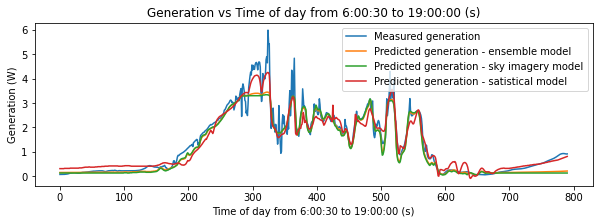

0.3437529043021775 0.12


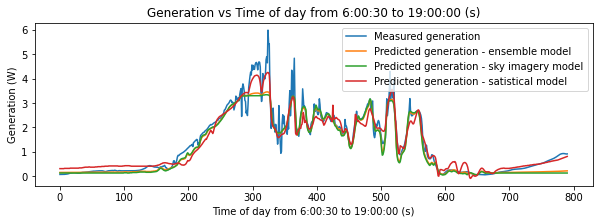

0.3420438086401757 0.13


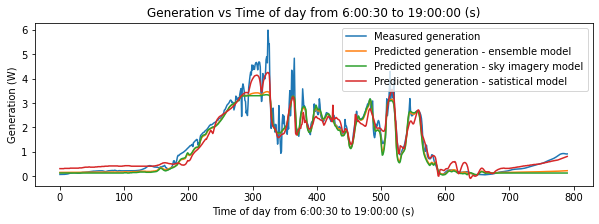

0.34035545374290876 0.14


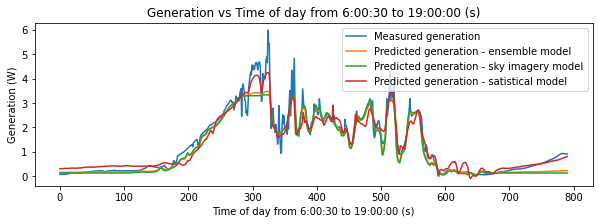

0.3386881497876384 0.15


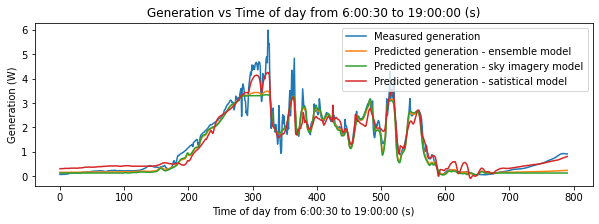

0.3370422091833243 0.16


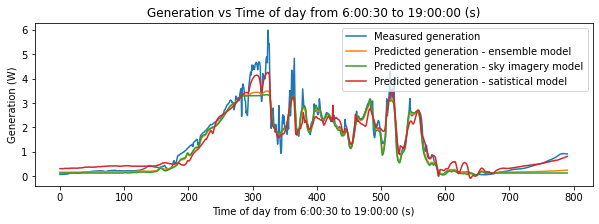

0.3354179464285511 0.17


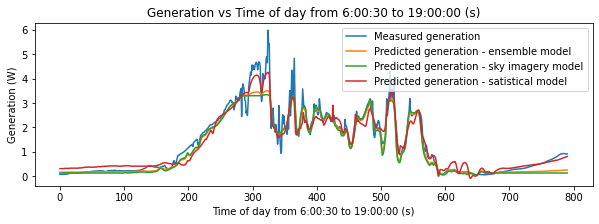

0.333815677960287 0.18


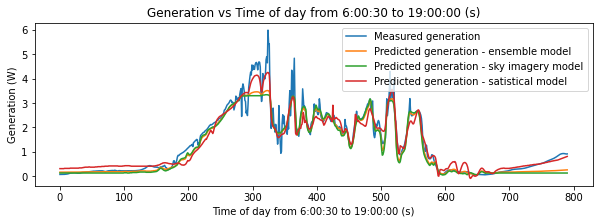

0.33223572199327756 0.19


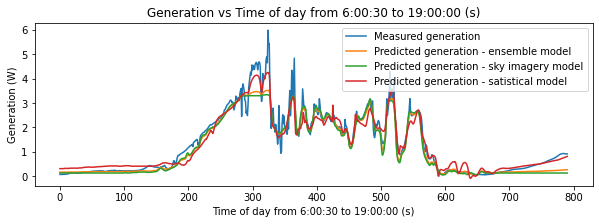

0.33067839834992524 0.2


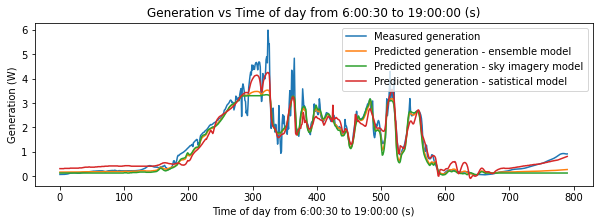

0.32914402828050526 0.21


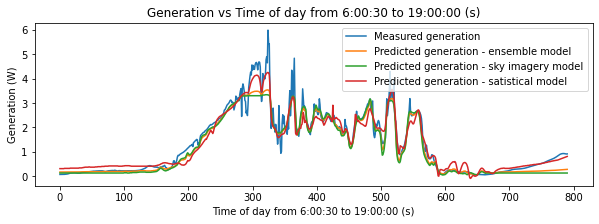

0.3276329342736065 0.22


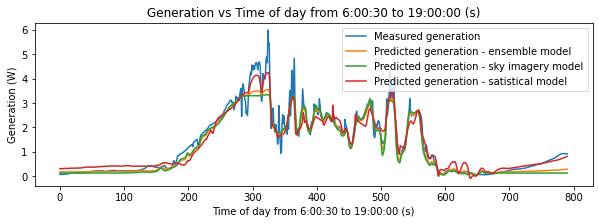

0.32614543985669536 0.23


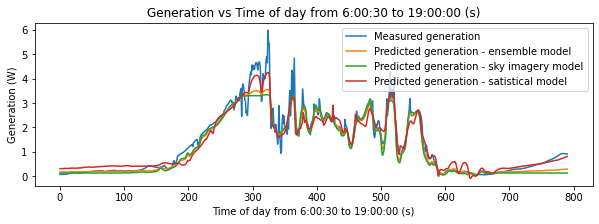

0.32468186938674337 0.24


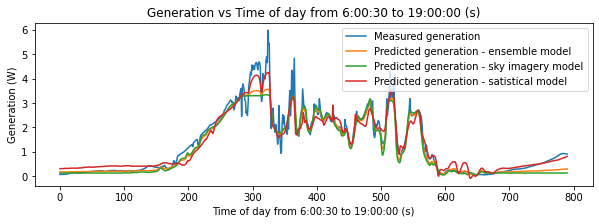

0.32324254783086975 0.25


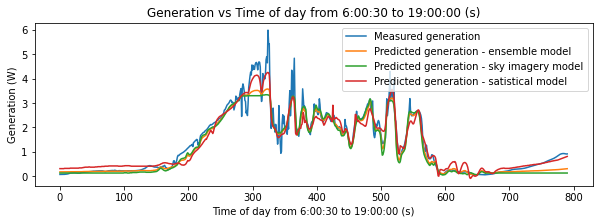

0.3218278005369999 0.26


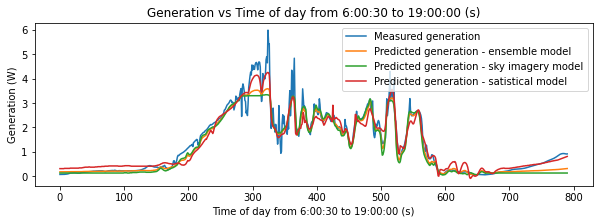

0.3204379529945584 0.27


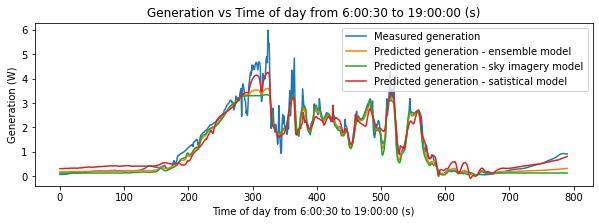

0.31907333058526116 0.28


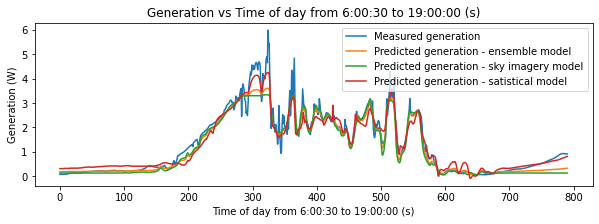

0.3177342583241042 0.29


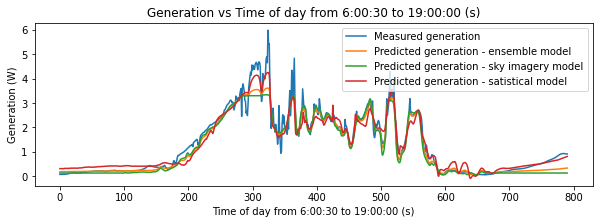

0.3164210605906869 0.3


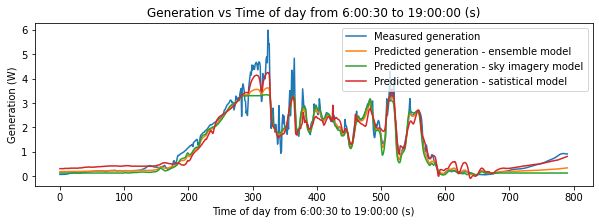

0.3151340608510451 0.31


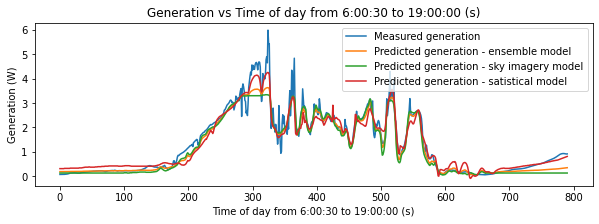

0.3138735813702302 0.32


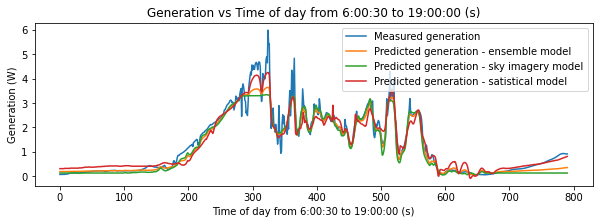

0.3126399429158845 0.33


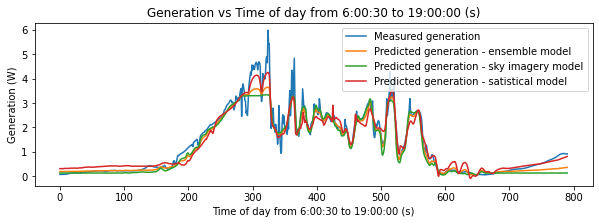

0.3114334644531469 0.34


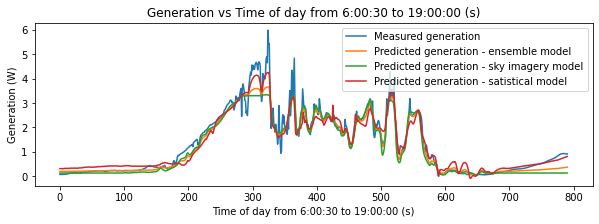

0.3102544628312384 0.35


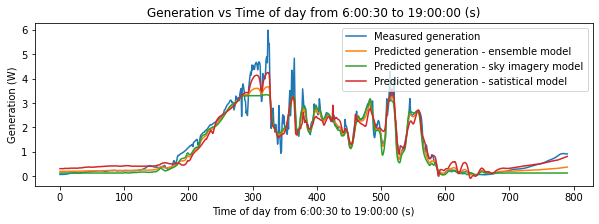

0.3091032524621508 0.36


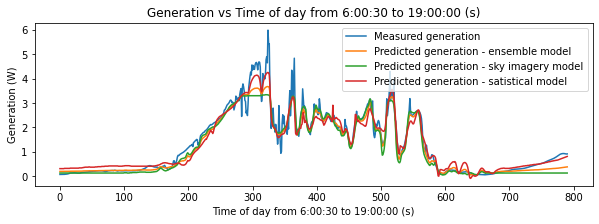

0.3079801449918954 0.37


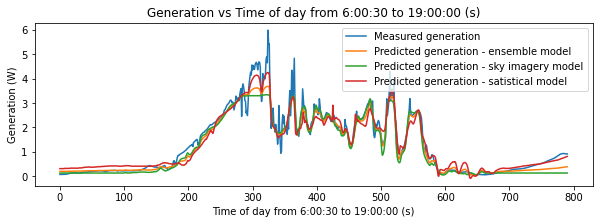

0.30688544896483194 0.38


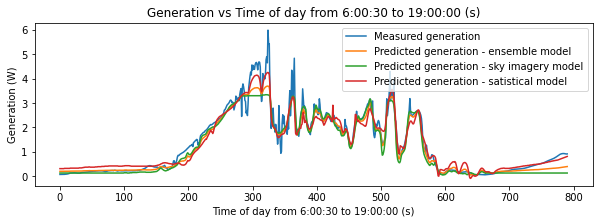

0.3058194694816418 0.39


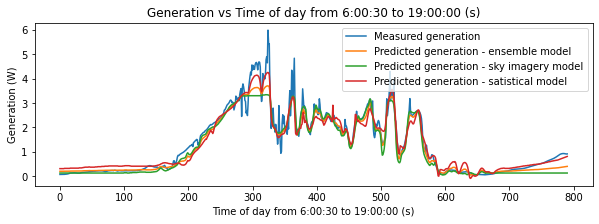

0.3047825078515637 0.4


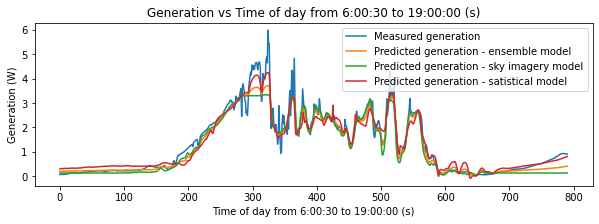

0.30377486123955766 0.41


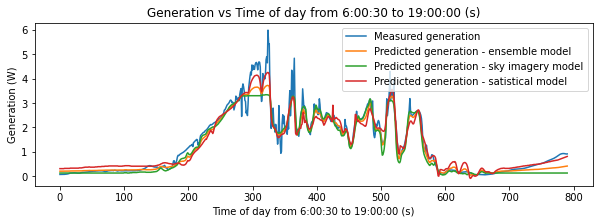

0.3027968223091279 0.42


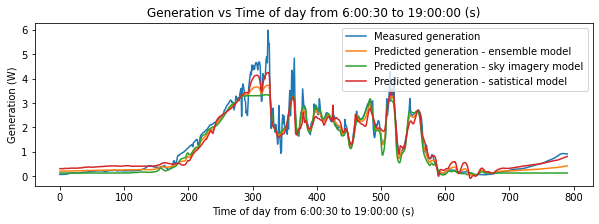

0.3018486788615575 0.43


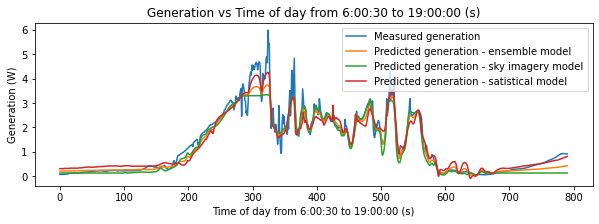

0.30093071347238515 0.44


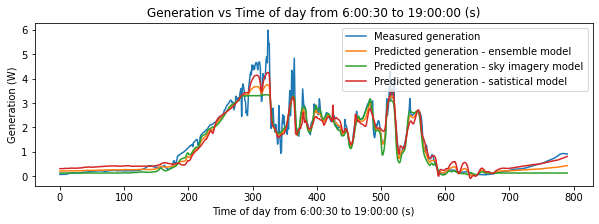

0.30004320312598076 0.45


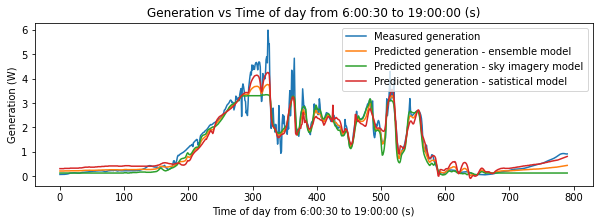

0.29918641884913055 0.46


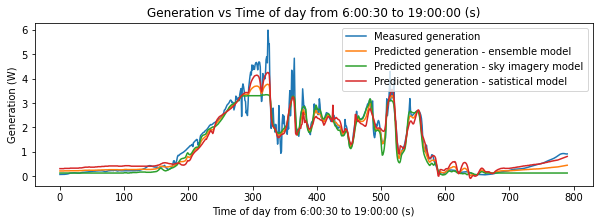

0.2983606253445737 0.47


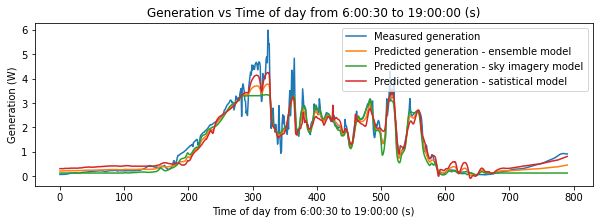

0.2975660806254835 0.48


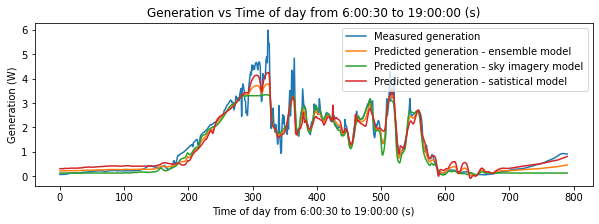

0.29680303565190697 0.49


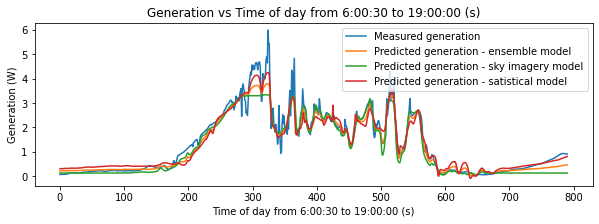

0.29607173397021774 0.5


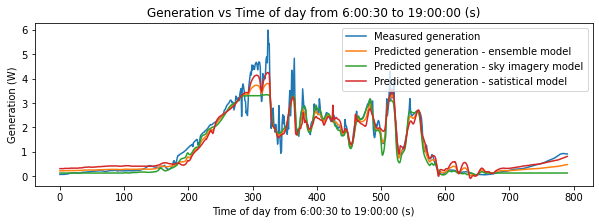

0.29537241135665454 0.51


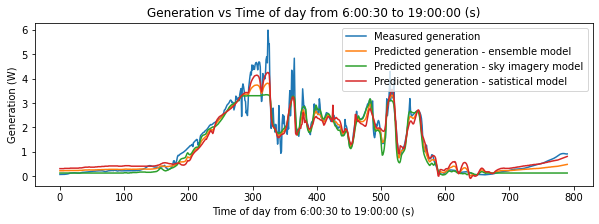

0.29470529546604185 0.52


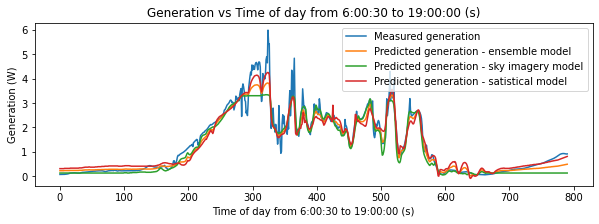

0.2940706054868082 0.53


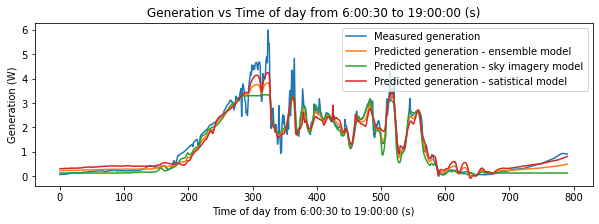

0.2934685518034224 0.54


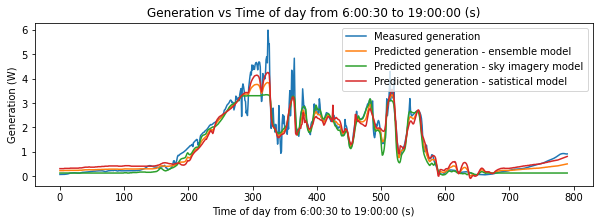

0.2928993356673704 0.55


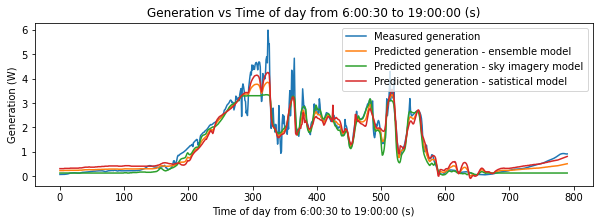

0.29236314887780346 0.56


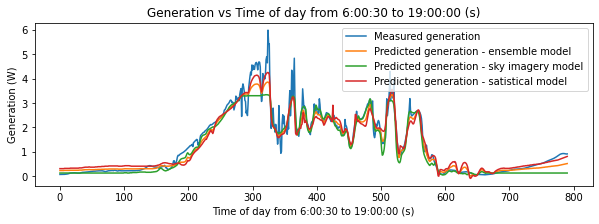

0.2918601734729685 0.57


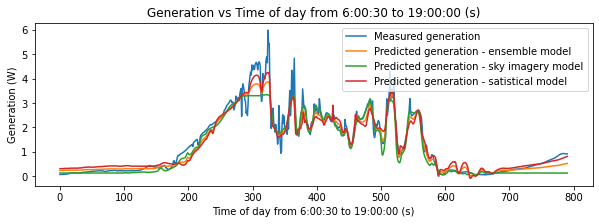

0.29139058143352353 0.58


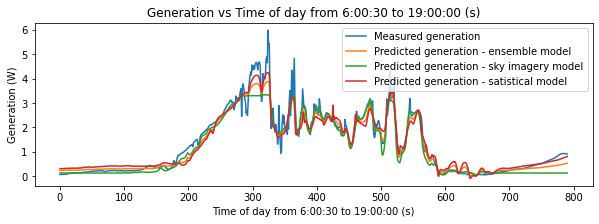

0.2909545343988151 0.59


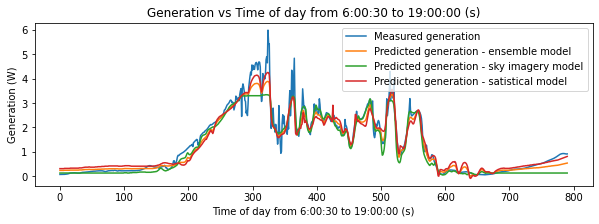

0.2905521833971736 0.6


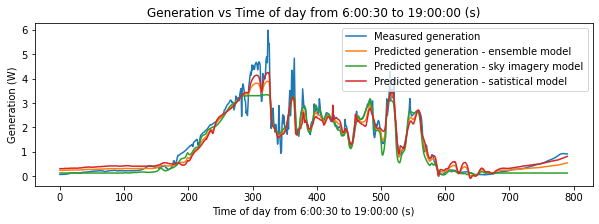

0.29018366859123385 0.61


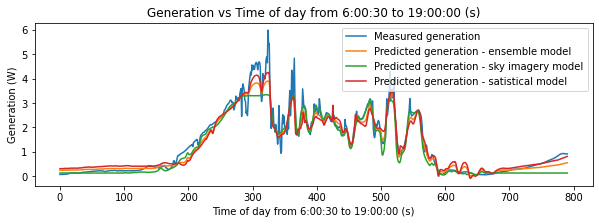

0.2898491190392653 0.62


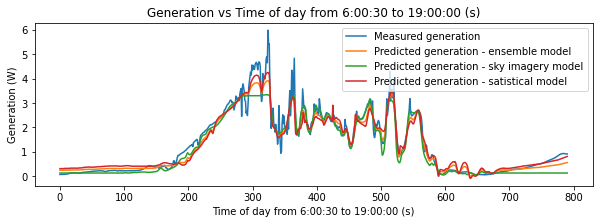

0.28954865247342837 0.63


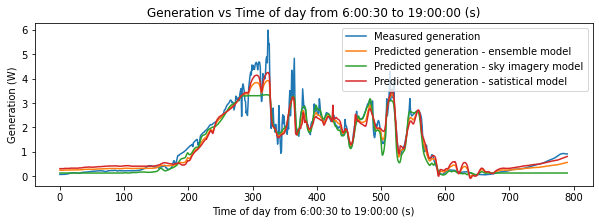

0.2892823750958347 0.64


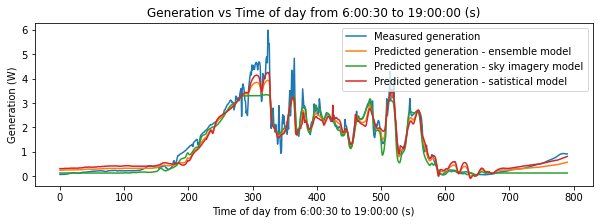

0.28905038139321865 0.65


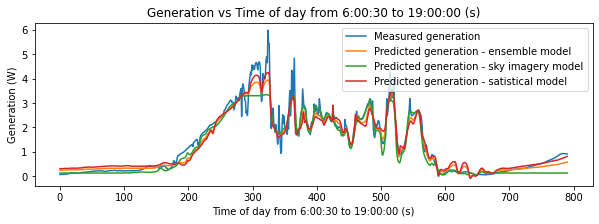

0.2888527539709671 0.66


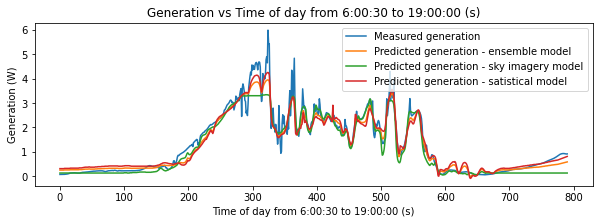

0.28868956340717894 0.67


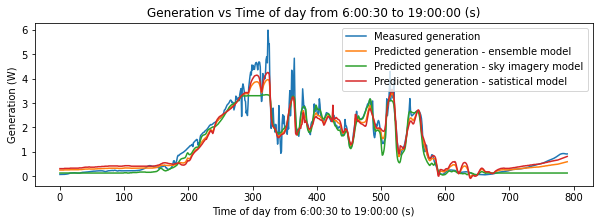

0.28856086812735393 0.68


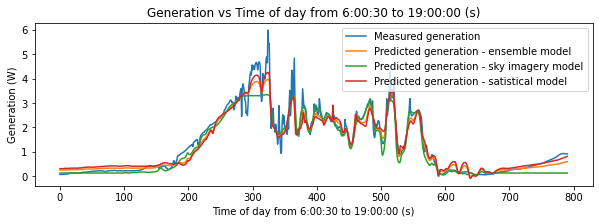

0.2884667143002215 0.69


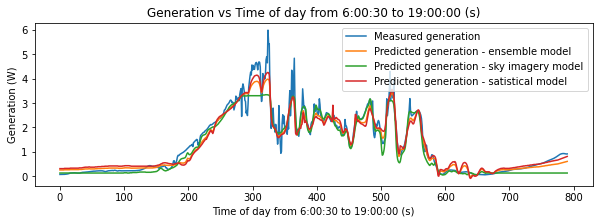

0.2884071357551475 0.7


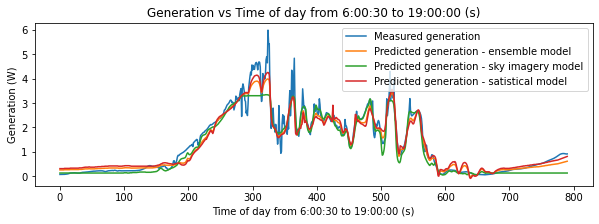

0.2883821539214576 0.71


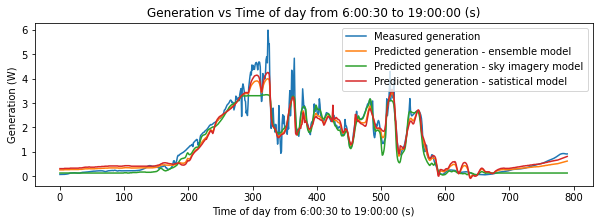

0.28839177778993536 0.72


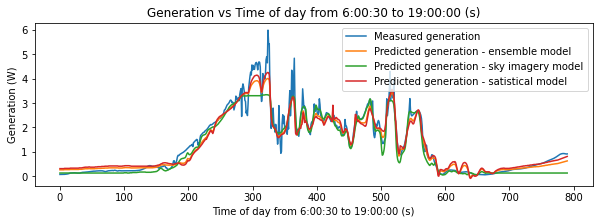

0.28843600389665036 0.73


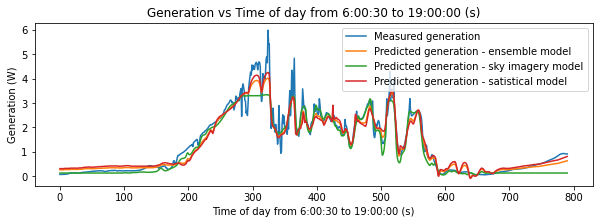

0.28851481632919074 0.74


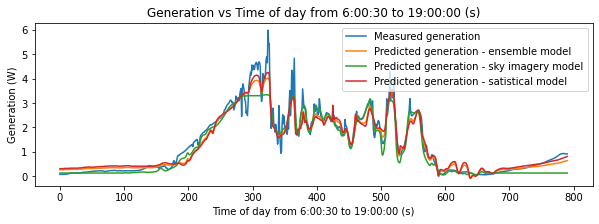

0.2886281867552672 0.75


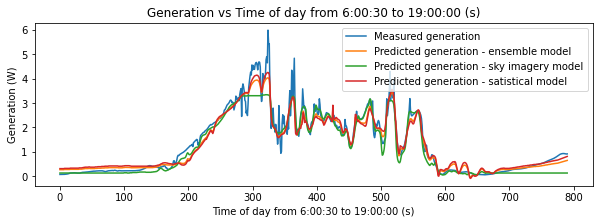

0.28877607447357756 0.76


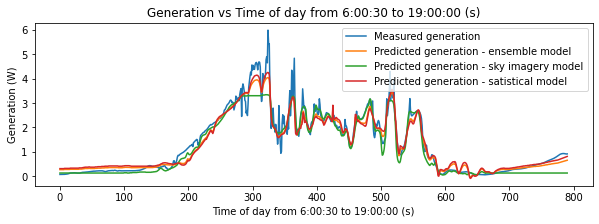

0.2889584264867073 0.77


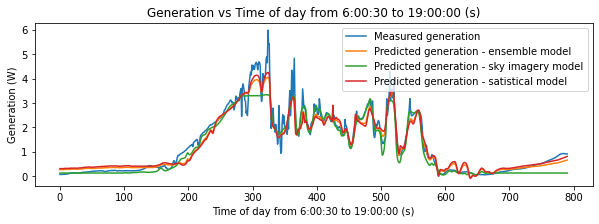

0.289175177595774 0.78


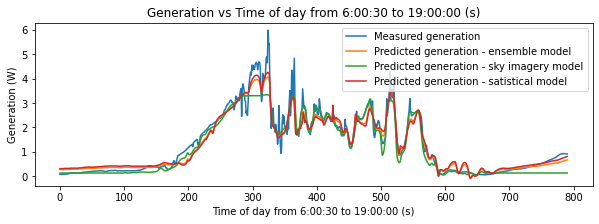

0.2894262505164136 0.79


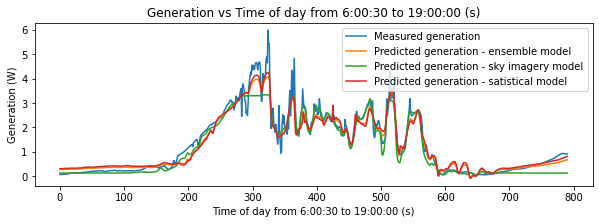

0.28971155601563664 0.8


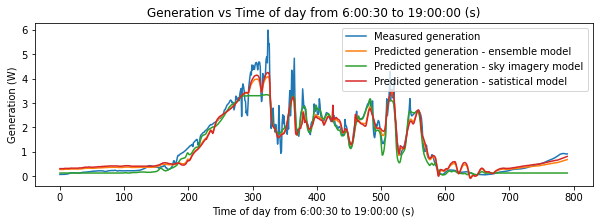

0.2900309930689848 0.81


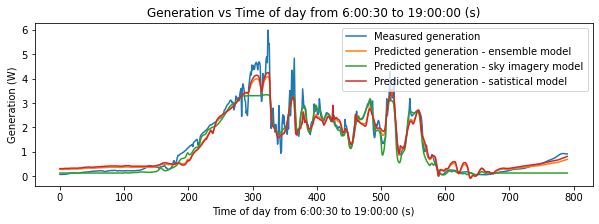

0.2903844490373592 0.82


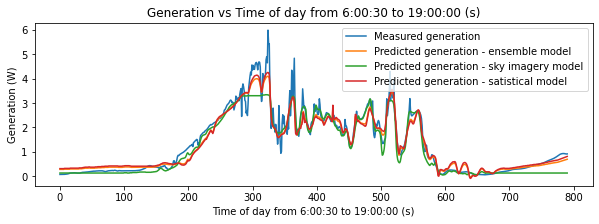

0.2907717998627941 0.83


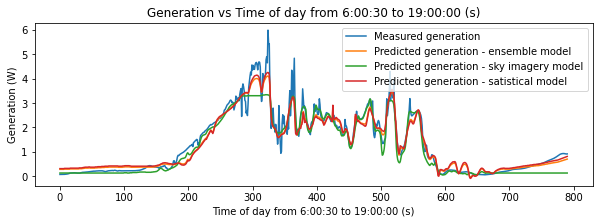

0.2911929102824034 0.84


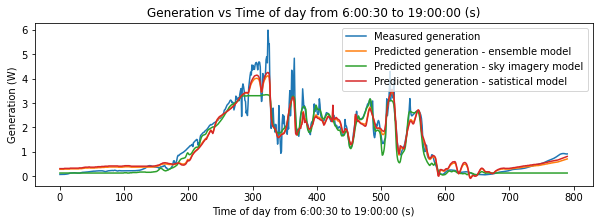

0.29164763405965005 0.85


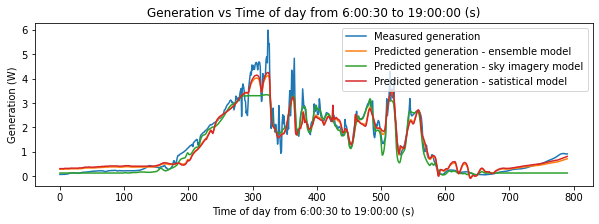

0.2921358142320391 0.86


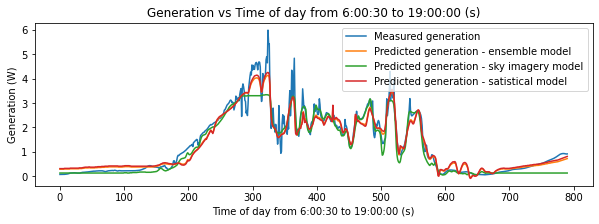

0.292657283374274 0.87


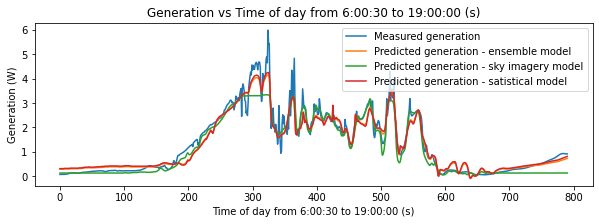

0.2932118638758888 0.88


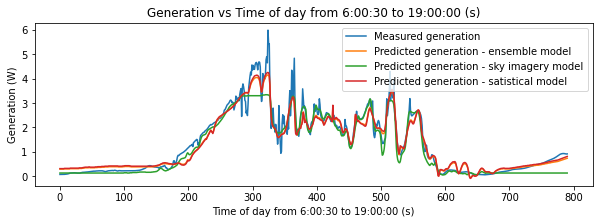

0.29379936823230973 0.89


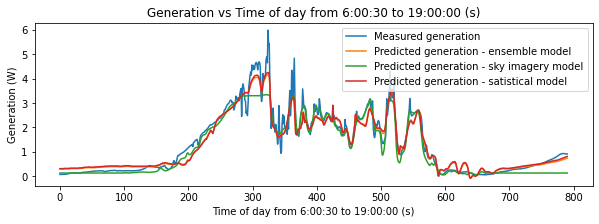

0.2944195993482847 0.9


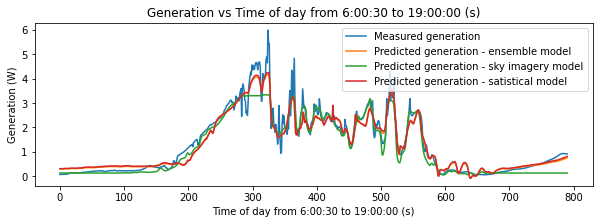

0.2950723508525898 0.91


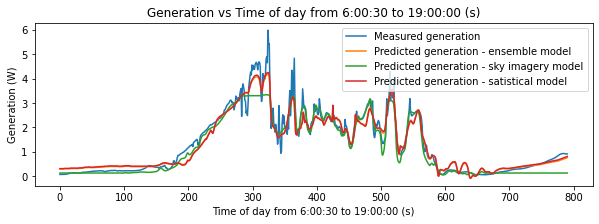

0.2957574074228947 0.92


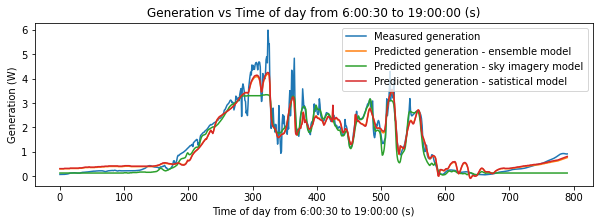

0.29647454511967664 0.93


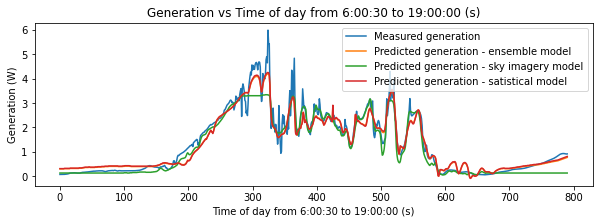

0.29722353172805027 0.94


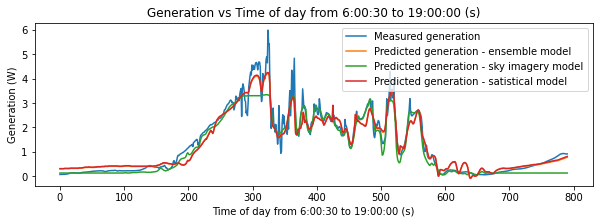

0.29800412710638735 0.95


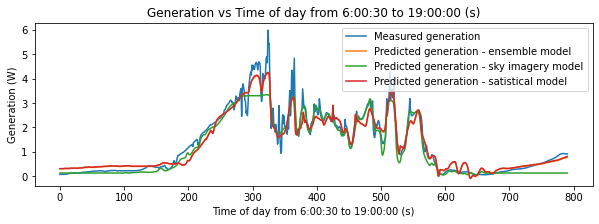

0.2988160835406183 0.96


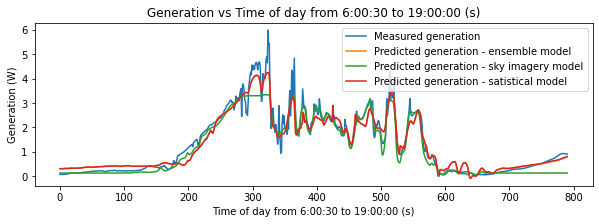

0.29965914610309585 0.97


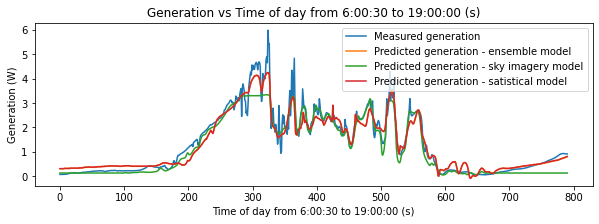

0.30053305301495215 0.98


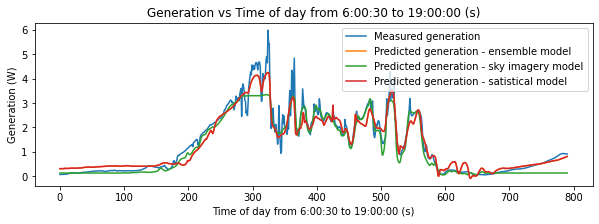

0.3014375360108764 0.99


In [ ]:
count = 0
for ensemble1 in ensemble:
  plt.figure(figsize=(10,3))
  #
  plt.plot( list(Expected1))
  plt.plot(ensemble1)
  plt.plot(predn)
  plt.plot(predn1)
  plt.title("Generation vs Time of day from 6:00:30 to 19:00:00 (s)")
  plt.ylabel("Generation (W)")
  plt.xlabel("Time of day from 6:00:30 to 19:00:00 (s)")
  plt.legend(('Measured generation','Predicted generation - ensemble model', 'Predicted generation - sky imagery model', 'Predicted generation - satistical model'))
  plt.show()
  print(RMSE[count], weights_list[count]/100)
  count +=1

In [ ]:
weights_list = list(range(0,100,1))

100 100


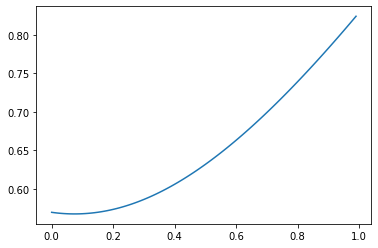

In [ ]:

weights_list = list(map(lambda x: x/100,weights_list))
print(len(weights_list),len(RMSE))
plt.plot( weights_list,RMSE)
# plt.plot()

In [ ]:
weights_list

[0.0,
 0.01,
 0.02,
 0.03,
 0.04,
 0.05,
 0.06,
 0.07,
 0.08,
 0.09,
 0.1,
 0.11,
 0.12,
 0.13,
 0.14,
 0.15,
 0.16,
 0.17,
 0.18,
 0.19,
 0.2,
 0.21,
 0.22,
 0.23,
 0.24,
 0.25,
 0.26,
 0.27,
 0.28,
 0.29,
 0.3,
 0.31,
 0.32,
 0.33,
 0.34,
 0.35,
 0.36,
 0.37,
 0.38,
 0.39,
 0.4,
 0.41,
 0.42,
 0.43,
 0.44,
 0.45,
 0.46,
 0.47,
 0.48,
 0.49,
 0.5,
 0.51,
 0.52,
 0.53,
 0.54,
 0.55,
 0.56,
 0.57,
 0.58,
 0.59,
 0.6,
 0.61,
 0.62,
 0.63,
 0.64,
 0.65,
 0.66,
 0.67,
 0.68,
 0.69,
 0.7,
 0.71,
 0.72,
 0.73,
 0.74,
 0.75,
 0.76,
 0.77,
 0.78,
 0.79,
 0.8,
 0.81,
 0.82,
 0.83,
 0.84,
 0.85,
 0.86,
 0.87,
 0.88,
 0.89,
 0.9,
 0.91,
 0.92,
 0.93,
 0.94,
 0.95,
 0.96,
 0.97,
 0.98,
 0.99]

In [ ]:
RMSE

[0.5694155398223255,
 0.5688953140463264,
 0.5684496751901328,
 0.568078798786618,
 0.5677828313405641,
 0.5675618900406798,
 0.5674160625283451,
 0.5673454067241344,
 0.5673499507129238,
 0.5674296926881086,
 0.5675846009551936,
 0.5678146139947371,
 0.5681196405843575,
 0.5684995599792376,
 0.5689542221503018,
 0.5694834480789619,
 0.5700870301071003,
 0.5707647323406941,
 0.5715162911052809,
 0.5723414154512216,
 0.5732397877065587,
 0.5742110640750443,
 0.5752548752767845,
 0.5763708272287943,
 0.5775585017626188,
 0.5788174573761037,
 0.5801472300162908,
 0.5815473338903671,
 0.5830172623015493,
 0.5845564885067766,
 0.5861644665930662,
 0.5878406323694163,
 0.5895844042711763,
 0.5913951842738496,
 0.5932723588133745,
 0.5952152997099868,
 0.5972233650929066,
 0.5992959003231386,
 0.6014322389118565,
 0.6036317034319157,
 0.6058936064202068,
 0.6082172512686842,
 0.610601933102053,
 0.6130469396402495,
 0.6155515520439927,
 0.6181150457418425,
 0.6207366912373503,
 0.623415754895